# Loading Environment

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import glob
from datetime import datetime
#import warnings
#warnings.simplefilter('ignore')
import scipy as sp
import scipy.ndimage
import numpy as np
import pandas as pd
import tensorflow as tf
import skimage
import skimage.exposure
import mahotas as mh
from sklearn.model_selection import KFold
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
import h5py
from tqdm import tqdm_notebook
from IPython.display import display
from dual_IDG import DualImageDataGenerator

Using TensorFlow backend.


In [4]:
import keras
from keras.models import Sequential, Model
from keras.layers import Dense, Dropout, Activation, Flatten, BatchNormalization, \
    Conv2D, MaxPooling2D, ZeroPadding2D, Input, Embedding, \
    Lambda, UpSampling2D, Cropping2D, Concatenate
from keras.utils import np_utils
from keras.optimizers import SGD, Adam
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau, CSVLogger
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K

In [5]:
print('Keras version:', keras.__version__)
print('TensorFlow version:', tf.__version__)

Keras version: 2.3.1
TensorFlow version: 2.0.0


In [6]:
K.set_image_data_format('channels_first')

# Defining evaluation metrics

In [7]:
def mean_IOU_gpu(X, Y):
    """Computes mean Intersection-over-Union (IOU) for two arrays of binary images.
    Assuming X and Y are of shape (n_images, w, h)."""
    
    #X_fl = K.clip(K.batch_flatten(X), K.epsilon(), 1.)
    #Y_fl = K.clip(K.batch_flatten(Y), K.epsilon(), 1.)
    X_fl = K.clip(K.batch_flatten(X), 0., 1.)
    Y_fl = K.clip(K.batch_flatten(Y), 0., 1.)
    X_fl = K.cast(K.greater(X_fl, 0.5), 'float32')
    Y_fl = K.cast(K.greater(Y_fl, 0.5), 'float32')

    intersection = K.sum(X_fl * Y_fl, axis=1)
    union = K.sum(K.maximum(X_fl, Y_fl), axis=1)
    # if union == 0, it follows that intersection == 0 => score should be 0.
    union = K.switch(K.equal(union, 0), K.ones_like(union), union)
    return K.mean(intersection / K.cast(union, 'float32'))


def mean_IOU_gpu_loss(X, Y):
    return -mean_IOU_gpu(X, Y)

In [8]:
def dice(y_true, y_pred):
    # Workaround for shape bug. For some reason y_true shape was not being set correctly
    #y_true.set_shape(y_pred.get_shape())

    # Without K.clip, K.sum() behaves differently when compared to np.count_nonzero()
    #y_true_f = K.clip(K.batch_flatten(y_true), K.epsilon(), 1.)
    #y_pred_f = K.clip(K.batch_flatten(y_pred), K.epsilon(), 1.)
    y_true_f = K.clip(K.batch_flatten(y_true), 0., 1.)
    y_pred_f = K.clip(K.batch_flatten(y_pred), 0., 1.)
    #y_pred_f = K.greater(y_pred_f, 0.5)

    intersection = 2 * K.sum(y_true_f * y_pred_f, axis=1)
    union = K.sum(y_true_f * y_true_f, axis=1) + K.sum(y_pred_f * y_pred_f, axis=1)
    return K.mean(intersection / union)


def dice_loss(y_true, y_pred):
    return -dice(y_true, y_pred)


def log_dice_loss(y_true, y_pred):
    return -K.log(dice(y_true, y_pred))


def dice_metric(y_true, y_pred):
    """An exact Dice score for binary tensors."""
    y_true_f = K.cast(K.greater(y_true, 0.5), 'float32')
    y_pred_f = K.cast(K.greater(y_pred, 0.5), 'float32')
    return dice(y_true_f, y_pred_f)

In [9]:
def tf_to_th_encoding(X):
    return np.rollaxis(X, 3, 1)


def th_to_tf_encoding(X):
    return np.rollaxis(X, 1, 4)

# Loading test dataset（sample_data)

In [10]:
import os
from platform import python_version_tuple

if python_version_tuple()[0] == 3:
    xrange = range

import numpy as np
import pandas as pd
import cv2
import imhandle as imh

In [53]:
def extract_sample_data(db_folder):
    """
    246 x 512 original, 256 x 256 after post-processing.

    Required schema:
    db_folder/
       sample_data/
          {id}_time_F2_[LE,RE]_[LS,RS].png
    """
    result_resolution = (256, 256)
#     image_path = db_folder
    X, file_names = imh.load_set(os.path.join(db_folder, 'sample_data'))
    rel_file_names = [os.path.split(fn)[-1] for fn in file_names]
    file_codes = [fn[:fn.rfind('.')] for fn in rel_file_names]
    for i in range(len(X)):
        h, w, ch = X[i].shape
        L_R_mark = file_codes[i][-5]
        side = result_resolution[0]
        # 定义目标大小
        target_size = 256
        start_y = (h - target_size) // 2
        if L_R_mark == 'L':
            # 裁剪图像
            X[i] = X[i][start_y:start_y + target_size,60:target_size + 60]
        elif L_R_mark == 'R':
            X[i] = X[i][start_y:start_y + target_size, w - target_size - 60:w - 60] 
        X[i] = imh.resize_image_to_square(X[i], side, pad_cval=0)
    return X, file_codes
X_test, file_codes = extract_sample_data(os.path.join(os.getcwd(), 'data'))

256 256
256 (256, 256, 3) 256
52266_04_F2_RE_LS


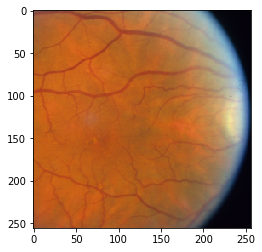

In [54]:
print(len(X_test), len(file_codes))
print(len(X_test), X_test[2].shape, len(file_codes))
print(file_codes[2])
plt.imshow(X_test[2])
plt.show()

In [55]:
test_idx = np.array(list(set(range(len(X_test)))))
print(test_idx)

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242 243 244 245 24

In [56]:
test_idg = DualImageDataGenerator()

# Loading train datasets and Conbine them

### Loading RIM_ONE_v3 dataset and DRIONS_DB dataset

In [69]:
from extract_data import *

In [117]:
h5f1 = h5py.File(os.path.join(os.getcwd(), 'data',  'RIM_ONE_v3.hdf5'), 'r')
h5f2 = h5py.File(os.path.join(os.getcwd(), 'data',  'DRIONS_DB.hdf5'), 'r')
# h5f3 = h5py.File(os.path.join(os.getcwd(), 'data',  'DRISHTI_GS.hdf5'), 'r')

In [118]:
X1 = h5f1['RIM-ONE v3/256 px/images']
Y1 = h5f1['RIM-ONE v3/256 px/disc']
X2 = h5f2['DRIONS-DB/256 px/images']
Y2 = h5f2['DRIONS-DB/256 px/disc']

### Loading HRF dataset

In [138]:
X3, Y3, filenames, is_ill = extract_HRF(os.path.join(os.getcwd(), 'data', 'HRF'))
len(X3), X3[0].shape, len(Y3), Y3[0].shape, len(filenames), len(is_ill)

(30, (3504, 3504, 3), 30, (3504, 3504, 1), 30, 30)

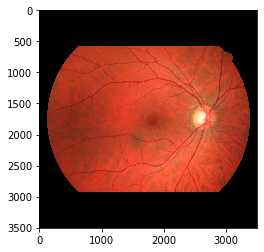

In [110]:
plt.imshow(X3[0])
plt.show()

In [111]:
for i in range(len(X3)):
    X3[i] = imh.resize_image_to_square(X3[i], 256, pad_cval=0)
#     Y3[i] = imh.resize_image_to_square(Y3[i], 256, pad_cval=0)
#     Y3[i] = Y3[i].reshape(Y_all[i].shape + (1,))

In [112]:
Y3 = np.array(Y3)

new_Y3 = np.empty((Y3.shape[0], 256, 256, Y3.shape[3]))

for i in range(Y3.shape[0]):
    img = Image.fromarray(Y3[i].squeeze())
    resized_img = img.resize((256, 256), Image.Resampling.LANCZOS)
    new_Y3[i] = np.expand_dims(np.array(resized_img), axis=-1)

print(new_Y3.shape)

(30, 256, 256, 1)


In [115]:
new_Y3 = np.array(new_Y3)
new_X3 = np.array(X3)

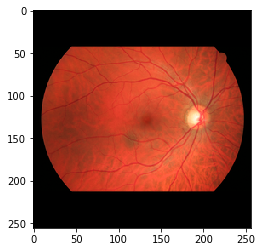

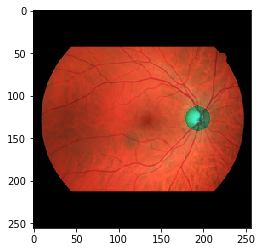

In [116]:
cur = new_X3[0].astype('float64')
mask = np.where(new_Y3[0].astype('float64'))
cur[mask] /= 4
cur = cur.astype('uint8')
plt.imshow(new_X3[0])
plt.show()
plt.imshow(cur)
plt.show()

### Loading DRISHTI_GS dataset

In [150]:
X4, Y4, file_codes = extract_DRISHTI_GS_train(os.path.join(os.getcwd(), 'data', 'DRISHTI_GS'), True, False)

In [151]:
print(len(X4),X4[0].shape, len(Y4), Y4[0].shape, len(file_codes))

50 (2040, 2040, 3) 50 (2040, 2040, 1) 50


In [161]:
def resize_data(X, Y, side=256):
    for i in range(len(X)):
        X[i] = imh.resize_image_to_square(X[i], 256, pad_cval=0)
    Y = np.array(Y)

    new_Y = np.empty((Y.shape[0], 256, 256, Y.shape[3]))

    for i in range(Y.shape[0]):
        img = Image.fromarray(Y[i].squeeze())
        resized_img = img.resize((256, 256), Image.Resampling.LANCZOS)
        new_Y[i] = np.expand_dims(np.array(resized_img), axis=-1)

    new_Y = np.array(new_Y)
    new_X = np.array(X)
    return new_X, new_Y

In [152]:
for i in range(len(X4)):
    X4[i] = imh.resize_image_to_square(X4[i], 256, pad_cval=0)
Y4 = np.array(Y4)

new_Y4 = np.empty((Y4.shape[0], 256, 256, Y4.shape[3]))

for i in range(Y4.shape[0]):
    img = Image.fromarray(Y4[i].squeeze())
    resized_img = img.resize((256, 256), Image.Resampling.LANCZOS)
    new_Y4[i] = np.expand_dims(np.array(resized_img), axis=-1)

new_Y4 = np.array(new_Y4)
new_X4 = np.array(X4)
print(new_X4.shape, new_Y4.shape)

(50, 256, 256, 3) (50, 256, 256, 1)


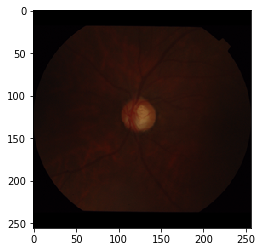

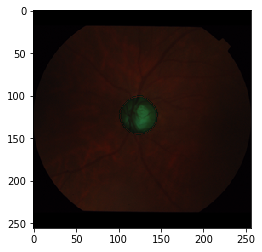

In [153]:
cur = new_X4[0].astype('float64')
mask = np.where(new_Y4[0].astype('float64'))
cur[mask] /= 4
cur = cur.astype('uint8')
plt.imshow(new_X4[0])
plt.show()
plt.imshow(cur)
plt.show()

### Loading RIM-ONE v2 dataset

In [159]:
X5, Y5, filenames5, is_ill5 = extract_RIM_ONE_v2(os.path.join(os.getcwd(), 'data', 'RIM-ONE v2'))

In [160]:
print(len(X5),X5[0].shape, len(Y5), Y5[0].shape)

455 (394, 394, 3) 455 (394, 394, 1)


In [162]:
new_X5, new_Y5 = resize_data(X5, Y5)
print(new_X5.shape, new_Y5.shape)

(455, 256, 256, 3) (455, 256, 256, 1)


### Conbine all of datasets

In [163]:
X = np.concatenate((X1, X2, new_X3, new_X4, new_X5), axis=0)
Y = np.concatenate((Y1, Y2, new_Y3, new_Y4, new_Y5), axis=0)

804 804 (804, 256, 256, 3) (804, 256, 256, 1)


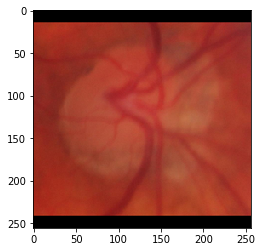

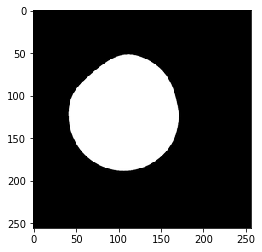

In [165]:
print(len(X), len(Y), X.shape, Y.shape)
plt.imshow(X[800])
plt.show()
plt.imshow(Y[800].squeeze(),cmap=plt.cm.Greys_r)
plt.show()

In [166]:
train_idx = np.array(list(set(range(len(X)))))
print(train_idx)

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242 243 244 245 24

# Generator of augmented data

In [167]:
train_idg = DualImageDataGenerator(#rescale=1/255.0,
                                   #samplewise_center=True, samplewise_std_normalization=True,
                                   horizontal_flip=True, vertical_flip=True,
                                   rotation_range=50, width_shift_range=0.15, height_shift_range=0.15,
                                   zoom_range=(0.7, 1.3),
                                   fill_mode='constant', cval=0.0)

# Preprocessing function and data generator

In [168]:
def preprocess(batch_X, batch_y=None, train_or_test='train'):
    batch_X = batch_X / 255.0
    batch_y = batch_y
    if train_or_test == 'train':
        batch_y = batch_y / 255.0
        batch_X, batch_y = next(train_idg.flow(batch_X, batch_y, batch_size=len(batch_X), shuffle=False))
    elif train_or_test == 'test':
        if batch_y is None:
            batch_X, batch_y = next(test_idg.flow(batch_X, None, batch_size=len(batch_X), shuffle=False))
        else:
            batch_X, batch_y = next(test_idg.flow(batch_X, batch_y, batch_size=len(batch_X), shuffle=False))
#         batch_X, batch_y = next(test_idg.flow(batch_X, batch_y, batch_size=len(batch_X), shuffle=False))
    batch_X = th_to_tf_encoding(batch_X)
    batch_X = [skimage.exposure.equalize_adapthist(batch_X[i]) 
               for i in range(len(batch_X))]
    batch_X = np.array(batch_X)
    batch_X = tf_to_th_encoding(batch_X)
    return batch_X, batch_y if batch_y is not None else None


def data_generator(X, y=None, train_or_test='train', batch_size=3, return_orig=False, stationary=False):    
    while True:
        if train_or_test == 'train':
            idx = np.random.choice(train_idx, size=batch_size)
        elif train_or_test == 'test':
            if stationary:
                idx = test_idx[:batch_size]
            else:
                idx = np.random.choice(test_idx, size=batch_size)
        batch_X = [X[i] for i in idx]
        batch_X = np.array(batch_X).copy()
        batch_X = tf_to_th_encoding(batch_X)
        if train_or_test == 'train':
            batch_y = [y[i] for i in idx]
            batch_y = np.array(batch_y).copy()
        else:
            batch_y = None
        if batch_y is not None:
            batch_y = tf_to_th_encoding(batch_y)
#             batch_y = tf_to_th_encoding(batch_y)
        if return_orig:
            batch_X_orig, batch_Y_orig = batch_X.copy(), batch_y.copy()if batch_y is not None else None
        
        batch_X, batch_y = preprocess(batch_X, batch_y if batch_y is not None else None, train_or_test)
        
        if not return_orig:
#             yield batch_X, batch_y
            if batch_y is not None:
                yield batch_X, batch_y
            else:
                yield batch_X, None
        else:
#             yield batch_X, batch_y, batch_X_orig, batch_Y_orig
            if batch_y is not None:
                yield batch_X, batch_y, batch_X_orig, batch_Y_orig
            else:
                yield batch_X, None, batch_X_orig, None

# Testing the data generator and generator for augmented data

In [169]:
gen = data_generator(X, Y, 'train', batch_size=1)
batch = next(gen)
batch[0].shape

(1, 3, 256, 256)

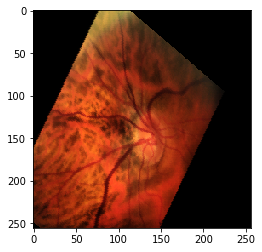

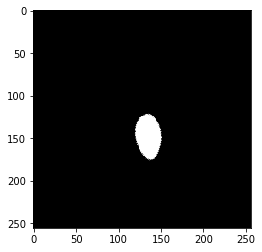

In [170]:
fig = plt.imshow(np.rollaxis(batch[0][0], 0, 3))
#plt.colorbar(mappable=fig)
plt.show()
plt.imshow(batch[1][0][0], cmap=plt.cm.Greys_r); plt.show()

# Training

In [57]:
X_valid = next(data_generator(X_test, None, train_or_test='test', batch_size=300, stationary=True))
X_valid = X_valid[0]

In [58]:
# X_valid = X_valid[0]
print(X_valid.shape)

(256, 3, 256, 256)


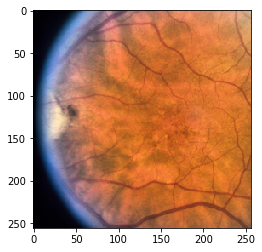

In [59]:
plt.imshow(np.rollaxis(X_valid[0], 0, 3)); plt.show()

# Define U-Net architecture

In [60]:
def get_unet_light(img_rows=256, img_cols=256):
    inputs = Input((3, img_rows, img_cols))
    conv1 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(inputs)
    conv1 = Dropout(0.3)(conv1)
    conv1 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool1)
    conv2 = Dropout(0.3)(conv2)
    conv2 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool2)
    conv3 = Dropout(0.3)(conv3)
    conv3 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    conv4 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool3)
    conv4 = Dropout(0.3)(conv4)
    conv4 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    conv5 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(pool4)
    conv5 = Dropout(0.3)(conv5)
    conv5 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv5)

    up6 = Concatenate(axis=1)([UpSampling2D(size=(2, 2))(conv5), conv4])
    conv6 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(up6)
    conv6 = Dropout(0.3)(conv6)
    conv6 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv6)

    up7 = Concatenate(axis=1)([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(up7)
    conv7 = Dropout(0.3)(conv7)
    conv7 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv7)

    up8 = Concatenate(axis=1)([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(up8)
    conv8 = Dropout(0.3)(conv8)
    conv8 = Conv2D(64, kernel_size=3, activation='relu', padding='same')(conv8)

    up9 = Concatenate(axis=1)([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(up9)
    conv9 = Dropout(0.3)(conv9)
    conv9 = Conv2D(32, kernel_size=3, activation='relu', padding='same')(conv9)

    conv10 = Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(conv9)
    #conv10 = Flatten()(conv10)

    model = Model(inputs=inputs, outputs=conv10)

    return model

In [61]:
model = get_unet_light(img_rows=256, img_cols=256)
model.compile(optimizer=SGD(lr=1e-4, momentum=0.95),
              loss=log_dice_loss,
              metrics=[mean_IOU_gpu, dice_metric])

model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 3, 256, 256)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 32, 256, 256) 896         input_1[0][0]                    
__________________________________________________________________________________________________
dropout_1 (Dropout)             (None, 32, 256, 256) 0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 32, 256, 256) 9248        dropout_1[0][0]                  
____________________________________________________________________________________________

# Training model

### If a pretrained model needs to be used, first run "Loading model" section below and then go the "Comprehensive visual check", skipping this section.

In [ ]:
history = model.fit(data_generator(X, Y, train_or_test='train', batch_size=2), 
                              steps_per_epoch=50,
                              max_queue_size=2,
                              
                              validation_data=(X_valid, Y_valid),
                              #validation_data=data_generator(X, Y, train_or_test='test', batch_size=1),
                              #nb_val_samples=100,
                              
                              epochs=400, verbose=1,
                              
                              callbacks=[CSVLogger(os.path.join(weights_folder, 'training_log.csv')),
                                         #ReduceLROnPlateau(monitor='val_loss', mode='min', factor=0.5, verbose=1, patience=40),
                                         ModelCheckpoint(os.path.join(weights_folder,
                                               #'weights.ep-{epoch:02d}-val_mean_IOU-{val_mean_IOU_gpu:.2f}_val_loss_{val_loss:.2f}.hdf5',
                                               'last_checkpoint.hdf5'),
                                               monitor='val_loss', mode='min', save_best_only=True, 
                                               save_weights_only=False, verbose=0)])

# Loading model

In [29]:
load_model = True   # lock
if not load_model:
    print('load_model == False')
else:
    # UNCOMMENT APPROPRIATE LINE(S) BELOW:
    # specify file:
    #model_path = '../models_weights/01.11,22:38,U-Net on DRIONS-DB 256 px, Adam, augm, log_dice loss/' \
    #    'weights.ep-20-val_mean_IOU-0.81_val_loss_0.08.hdf5'
    # or get the most recently altered file in a folder:
    model_folder = os.path.join(os.getcwd(), 'models_weights', 'U-Net light on RIM-ONE v3')
    
    model_path = max(glob.glob(os.path.join(model_folder, '*.hdf5')), key=os.path.getctime)
    if load_model and not os.path.exists(model_path):
        raise Exception('`model_path` does not exist')
    print('Loading weights from', model_path)

    if load_model:
        #with open(model_path + ' arch.json') as arch_file:
        #    json_string = arch_file.read()
        #new_model = model_from_json(json_string)
        model.load_weights(model_path)
    
    # Reading log statistics
    import pandas as pd
    
    log_path = os.path.join(model_folder, 'training_log.csv')
    if os.path.exists(log_path):
        log = pd.read_csv(log_path)
        if log['epoch'].dtype != 'int64':
            log = log.loc[log.epoch != 'epoch']
        print('\nmax val mean IOU: {}, at row:'.format(log['val_mean_IOU_gpu'].max()))
        print(log.loc[log['val_mean_IOU_gpu'].idxmax()])
        if 'val_dice_metric' in log.columns:
            print('\n' + 'max val dice_metric: {}, at row:'.format(log['val_dice_metric'].max()))
            print(log.loc[log['val_dice_metric'].idxmax()])
        if 'val_dice' in log.columns:
            print('\n' + 'max val dice: {}, at row:'.format(log['val_dice'].max()))
            print(log.loc[log['val_dice'].idxmax()])

Loading weights from /home/lhm/optic_disc/models_weights/U-Net light on RIM-ONE v3/last_checkpoint.hdf5

max val mean IOU: 0.8831598162651062, at row:
epoch               367.000000
dice_metric           0.932425
loss                  0.043670
mean_IOU_gpu          0.874642
val_dice_metric       0.936156
val_loss              0.042802
val_mean_IOU_gpu      0.883160
Name: 367, dtype: float64

max val dice_metric: 0.9361556768417358, at row:
epoch               367.000000
dice_metric           0.932425
loss                  0.043670
mean_IOU_gpu          0.874642
val_dice_metric       0.936156
val_loss              0.042802
val_mean_IOU_gpu      0.883160
Name: 367, dtype: float64


# Comprehensive visual check

image #0 :  52266_04_F2_LE_LS


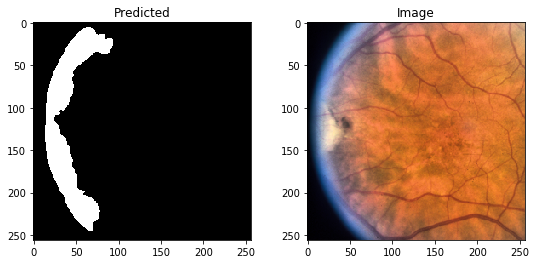

image #1 :  52266_04_F2_LE_RS


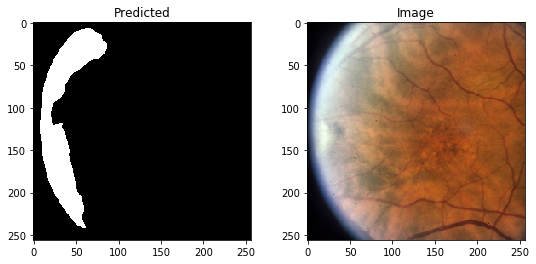

image #2 :  52266_04_F2_RE_LS


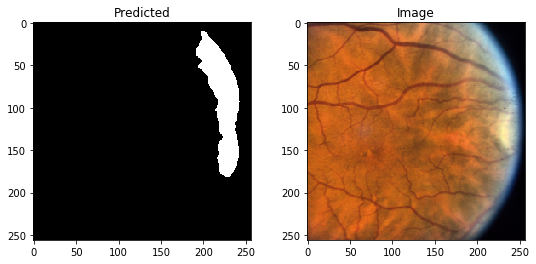

image #3 :  52266_04_F2_RE_RS


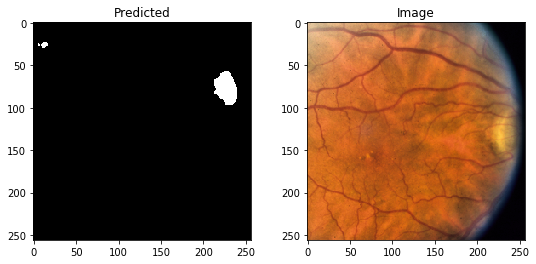

image #4 :  52266_06_F2_LE_LS


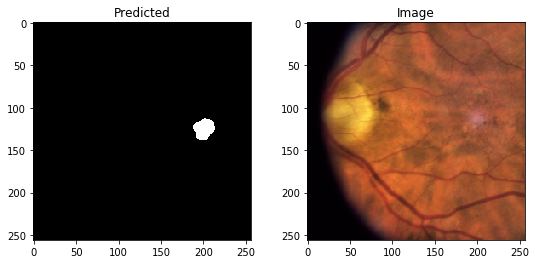

image #5 :  52266_06_F2_LE_RS


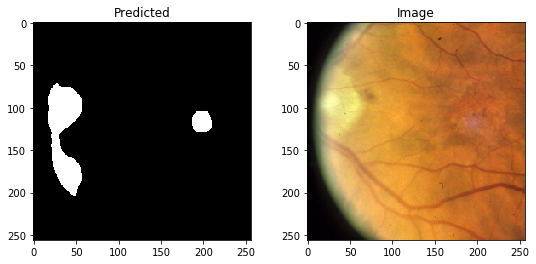

image #6 :  52266_06_F2_RE_LS


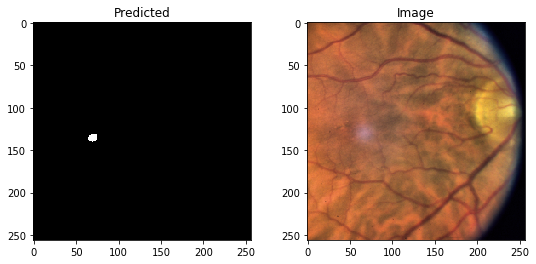

image #7 :  52266_06_F2_RE_RS


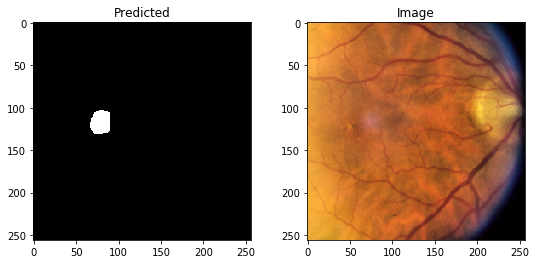

image #8 :  52266_08_F2_LE_LS


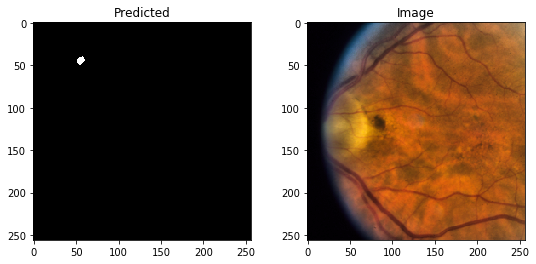

image #9 :  52266_08_F2_LE_RS


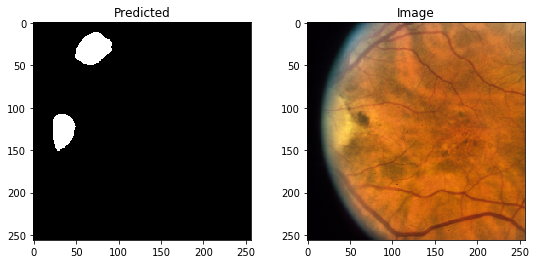

image #10 :  52266_08_F2_RE_LS


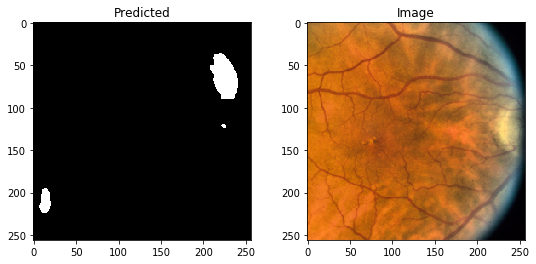

image #11 :  52266_08_F2_RE_RS


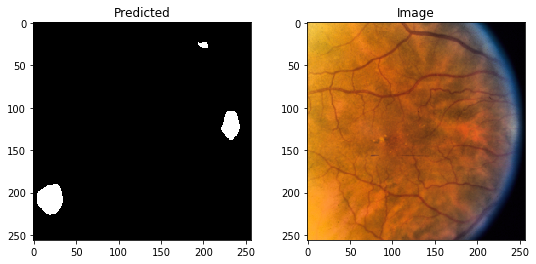

image #12 :  52266_10_F2_LE_LS


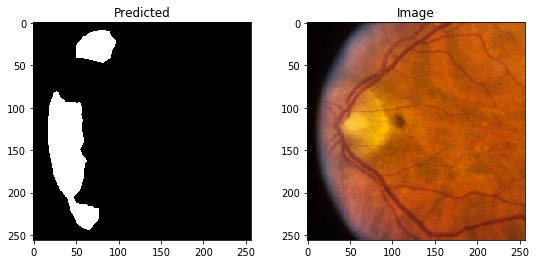

image #13 :  52266_10_F2_LE_RS


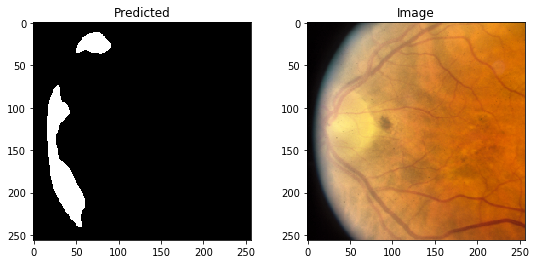

image #14 :  52266_10_F2_RE_LS


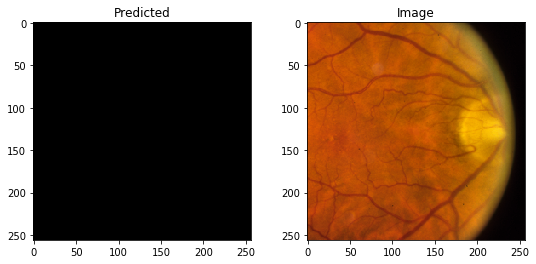

image #15 :  52266_10_F2_RE_RS


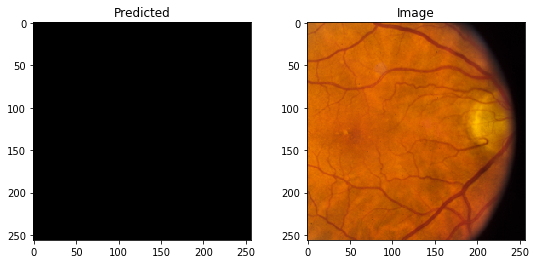

image #16 :  52266_12_F2_LE_LS


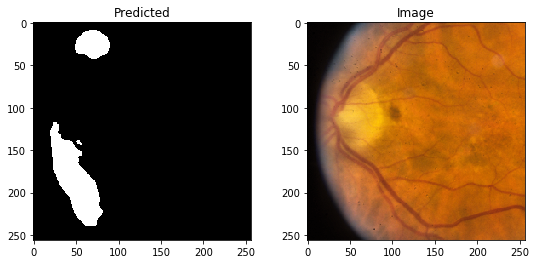

image #17 :  52266_12_F2_LE_RS


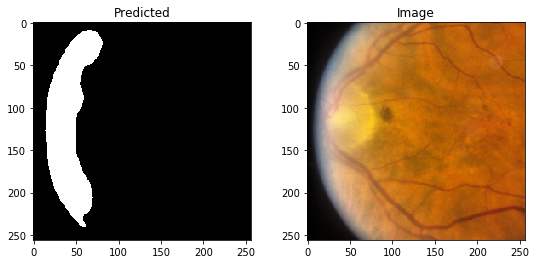

image #18 :  52266_12_F2_RE_LS


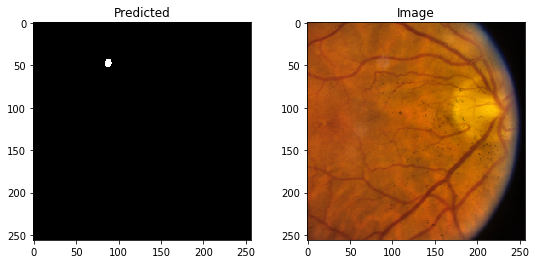

image #19 :  52266_12_F2_RE_RS


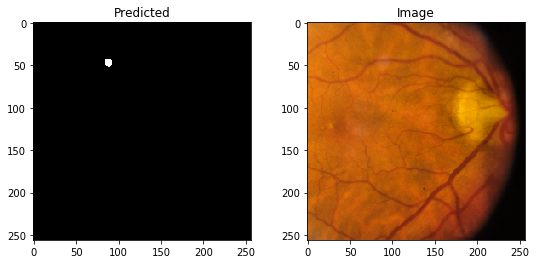

image #20 :  52266_14_F2_LE_LS


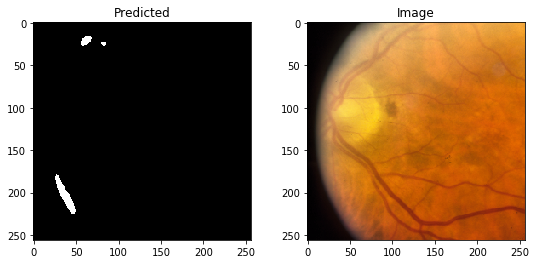

image #21 :  52266_14_F2_LE_RS


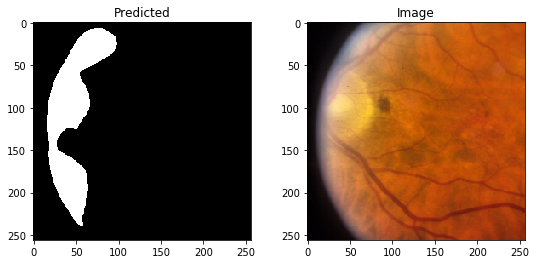

image #22 :  52266_14_F2_RE_LS


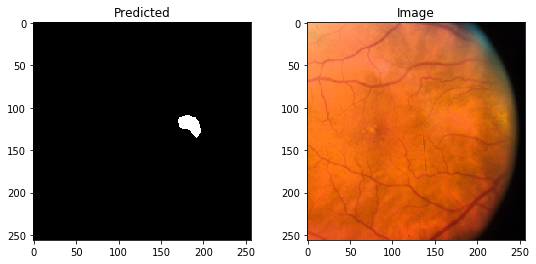

image #23 :  52266_14_F2_RE_RS


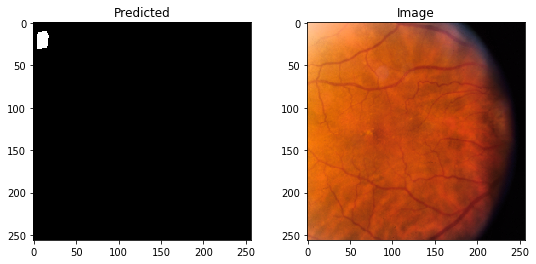

image #24 :  52266_16_F2_LE_LS


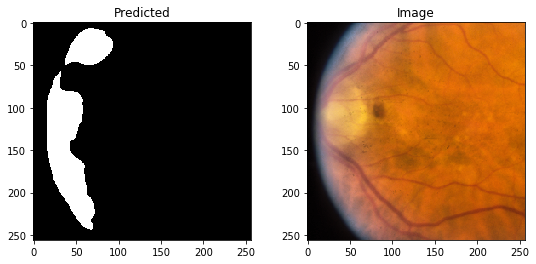

image #25 :  52266_16_F2_LE_RS


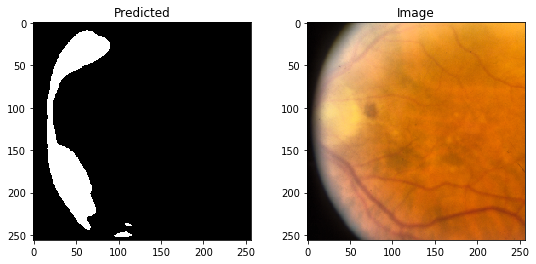

image #26 :  52266_16_F2_RE_LS


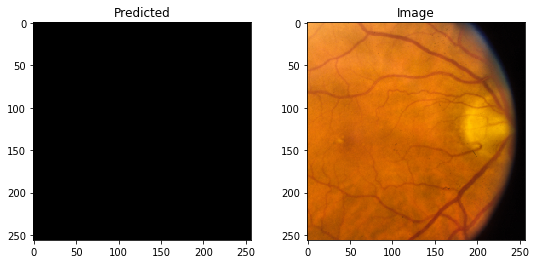

image #27 :  52266_16_F2_RE_RS


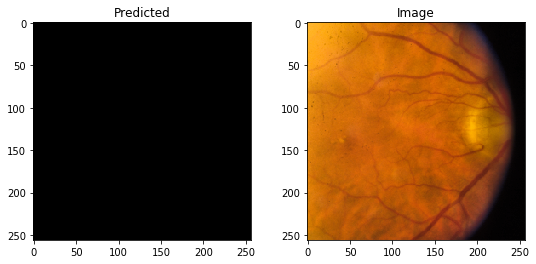

image #28 :  52266_18_F2_LE_LS


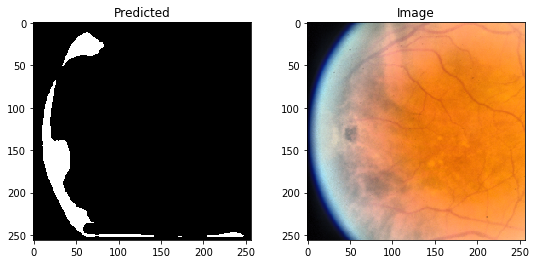

image #29 :  52266_18_F2_LE_RS


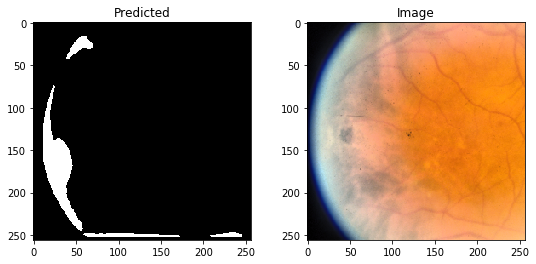

image #30 :  52266_18_F2_RE_LS


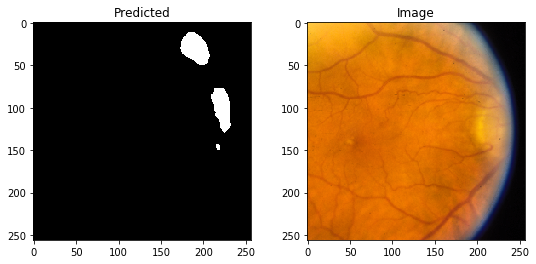

image #31 :  52266_18_F2_RE_RS


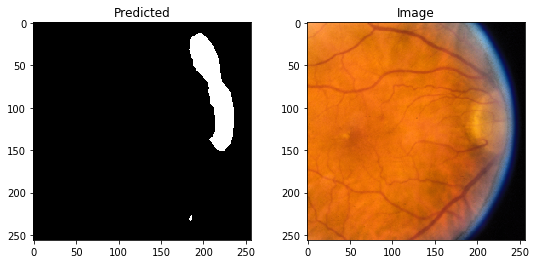

image #32 :  52266_20_F2_LE_LS


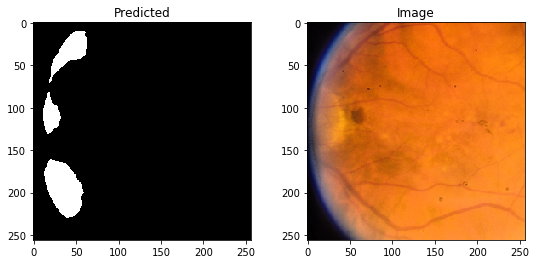

image #33 :  52266_20_F2_LE_RS


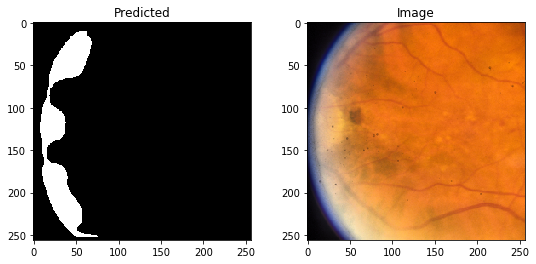

image #34 :  52266_20_F2_RE_LS


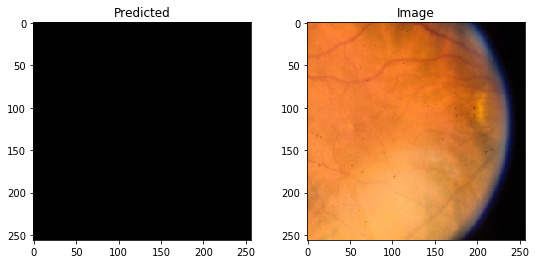

image #35 :  52266_20_F2_RE_RS


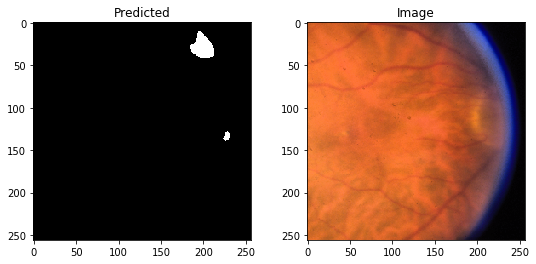

image #36 :  54361_04_F2_LE_LS


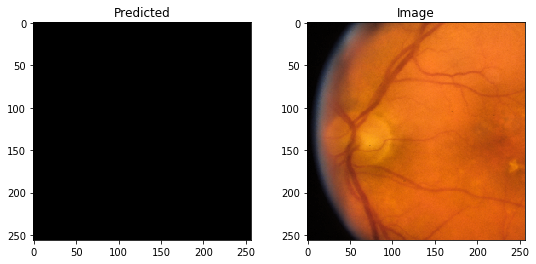

image #37 :  54361_04_F2_LE_RS


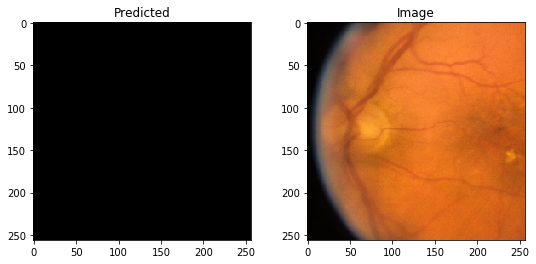

image #38 :  54361_04_F2_RE_LS


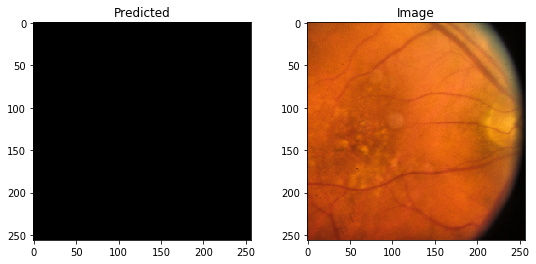

image #39 :  54361_04_F2_RE_RS


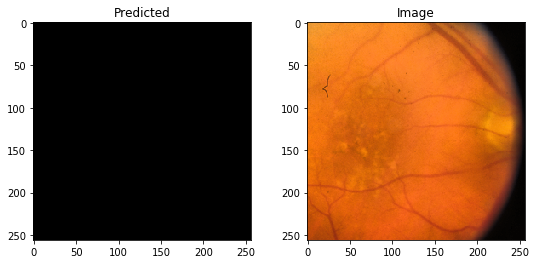

image #40 :  54682_06_F2_LE_LS


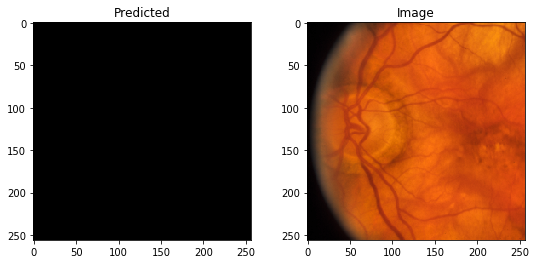

image #41 :  54682_06_F2_LE_RS


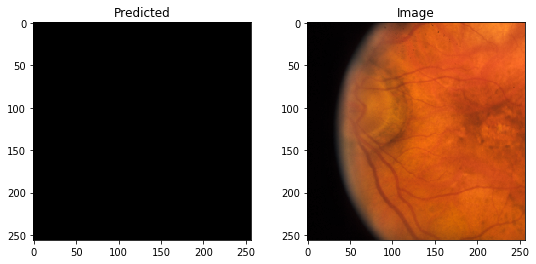

image #42 :  54682_06_F2_RE_LS


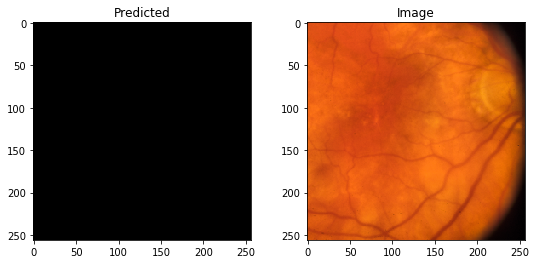

image #43 :  54682_06_F2_RE_RS


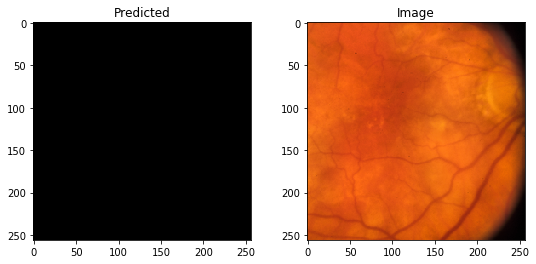

image #44 :  54682_08_F2_LE_LS


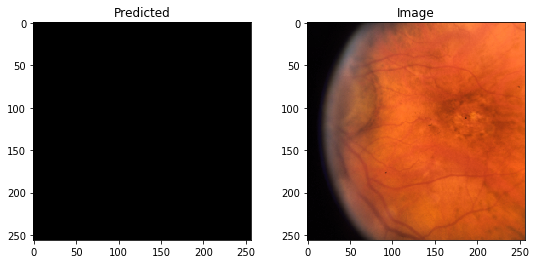

image #45 :  54682_08_F2_LE_RS


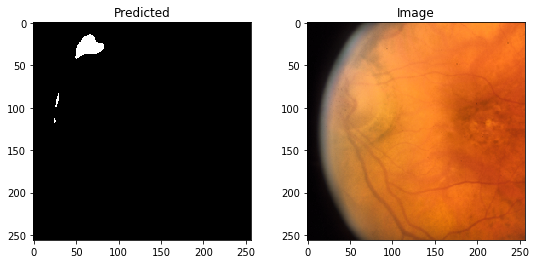

image #46 :  54682_08_F2_RE_LS


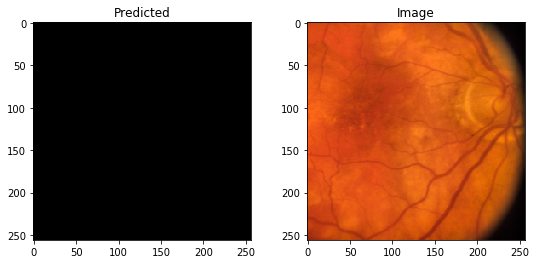

image #47 :  54682_08_F2_RE_RS


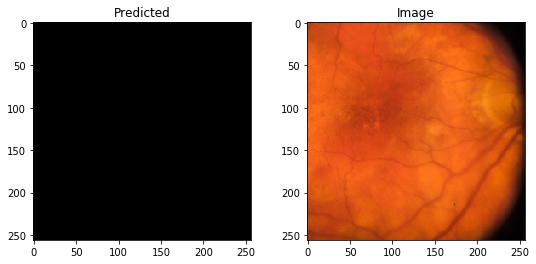

image #48 :  54682_10_F2_LE_LS


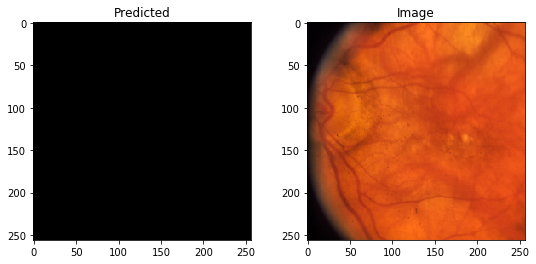

image #49 :  54682_10_F2_LE_RS


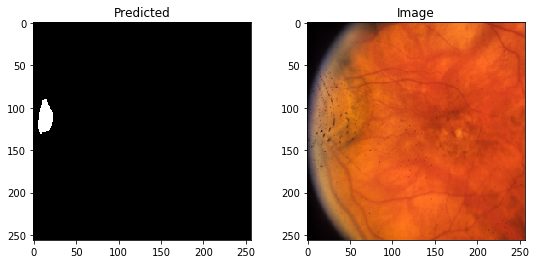

image #50 :  54682_10_F2_RE_LS


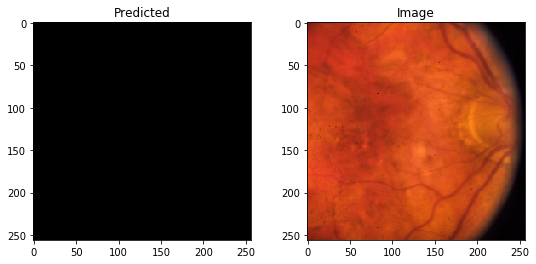

image #51 :  54682_10_F2_RE_RS


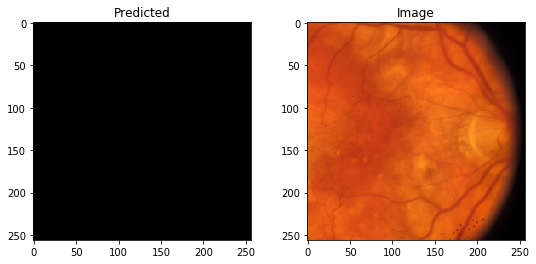

image #52 :  54682_12_F2_LE_LS


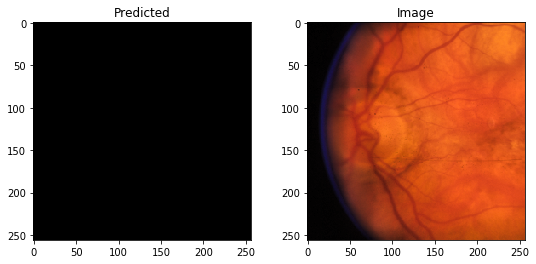

image #53 :  54682_12_F2_LE_RS


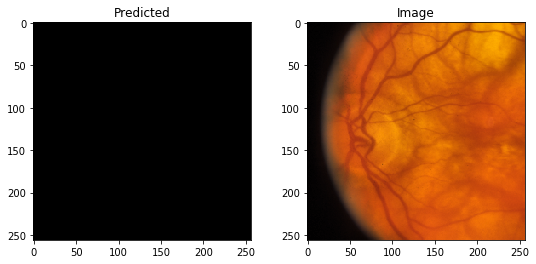

image #54 :  54682_12_F2_RE_LS


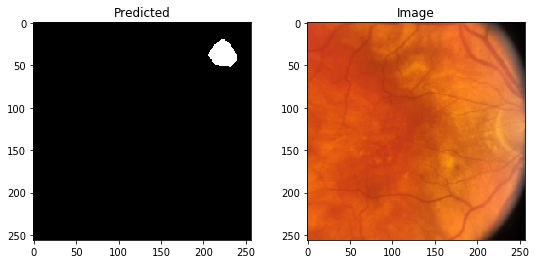

image #55 :  54682_12_F2_RE_RS


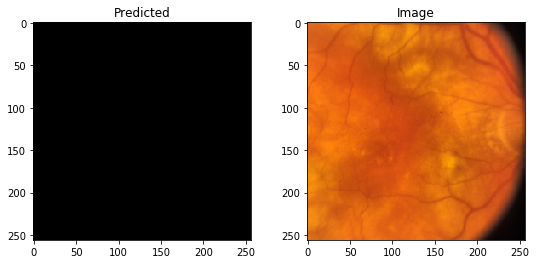

image #56 :  54682_16_F2_LE_LS


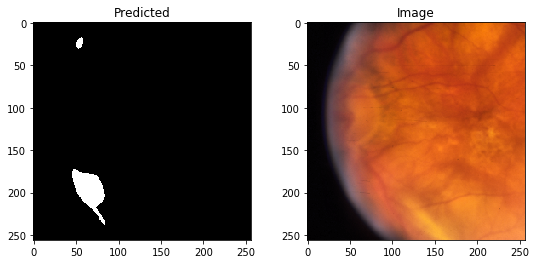

image #57 :  54682_16_F2_LE_RS


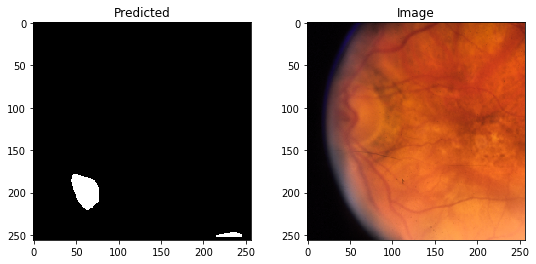

image #58 :  54682_16_F2_RE_LS


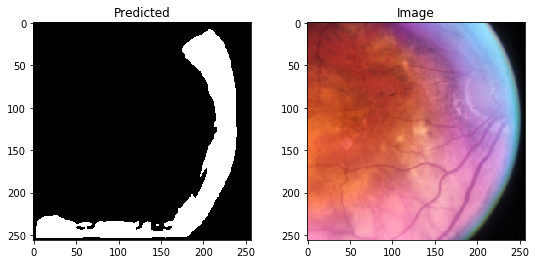

image #59 :  54682_16_F2_RE_RS


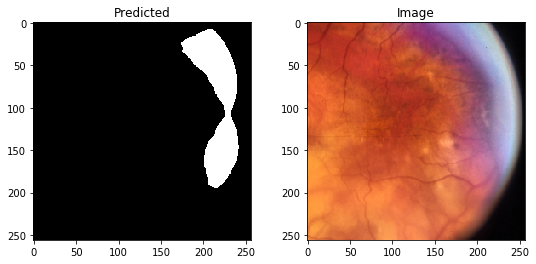

image #60 :  54682_18_F2_LE_LS


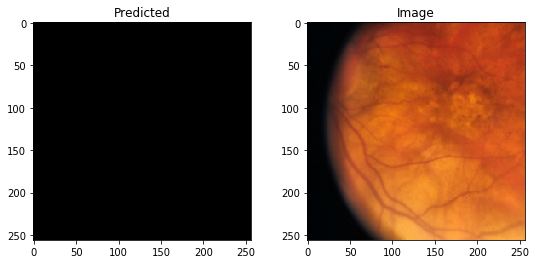

image #61 :  54682_18_F2_LE_RS


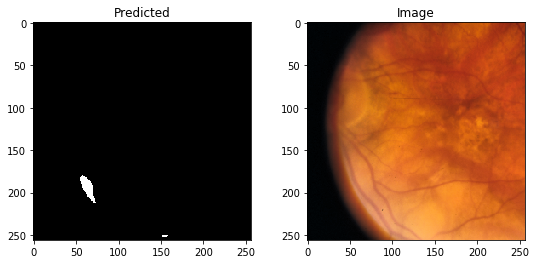

image #62 :  54682_18_F2_RE_LS


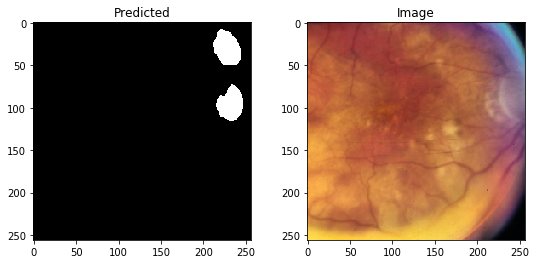

image #63 :  54682_18_F2_RE_RS


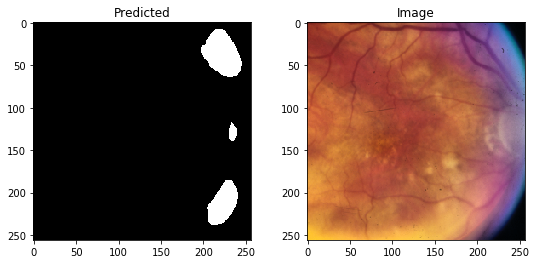

image #64 :  54682_20_F2_LE_LS


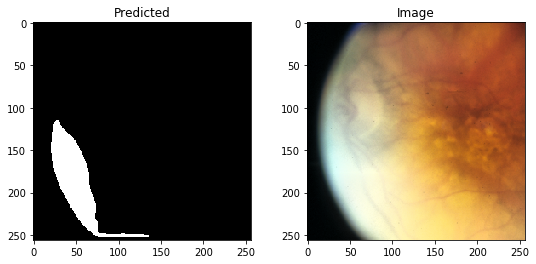

image #65 :  54682_20_F2_LE_RS


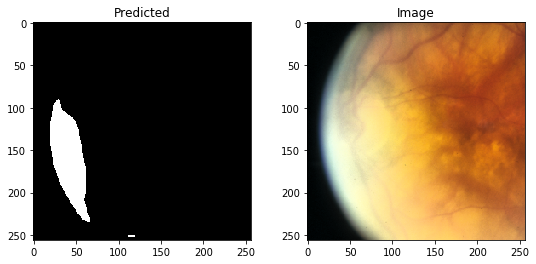

image #66 :  54682_20_F2_RE_LS


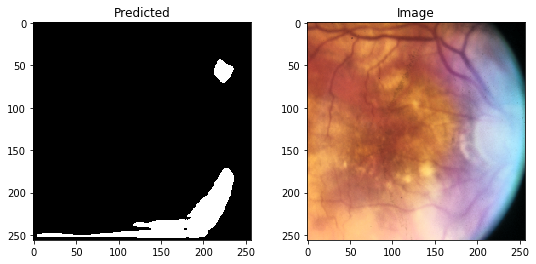

image #67 :  54682_20_F2_RE_RS


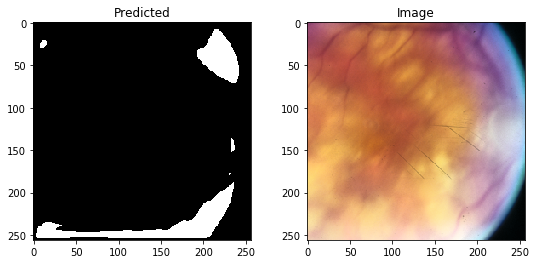

image #68 :  55429_04_F2_LE_LS


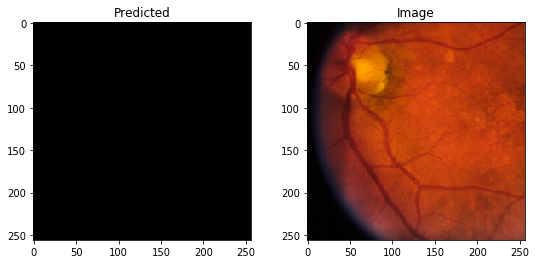

image #69 :  55429_04_F2_LE_RS


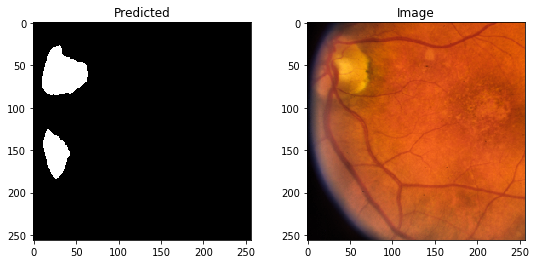

image #70 :  55429_04_F2_RE_LS


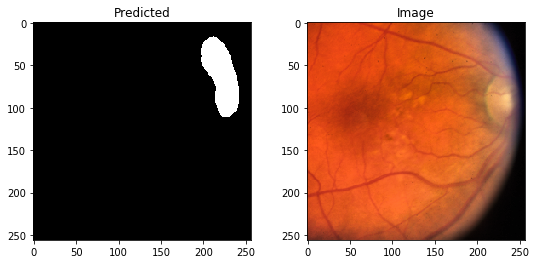

image #71 :  55429_04_F2_RE_RS


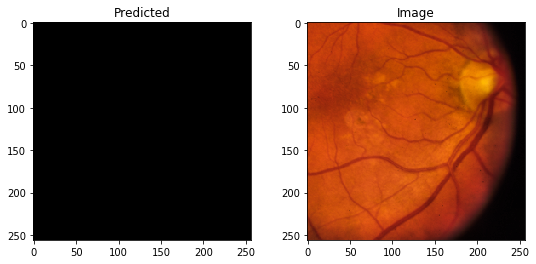

image #72 :  55429_06_F2_LE_LS


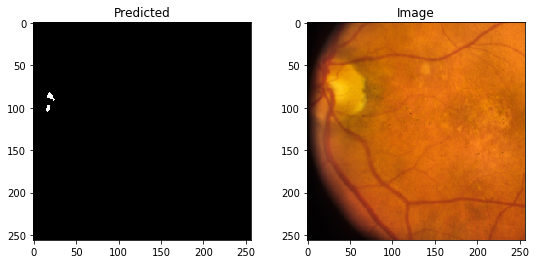

image #73 :  55429_06_F2_LE_RS


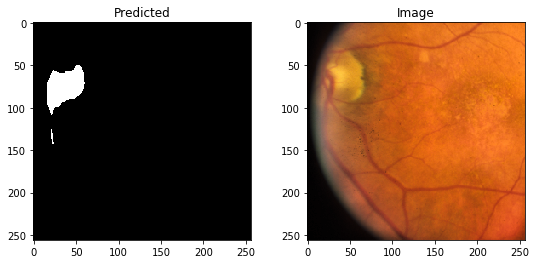

image #74 :  55429_06_F2_RE_LS


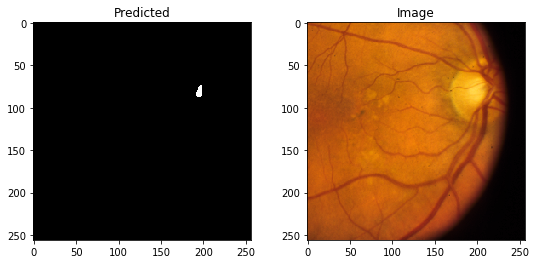

image #75 :  55429_06_F2_RE_RS


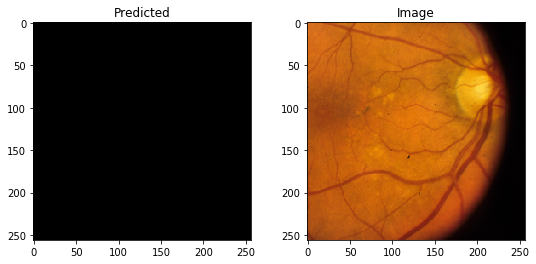

image #76 :  55429_08_F2_LE_LS


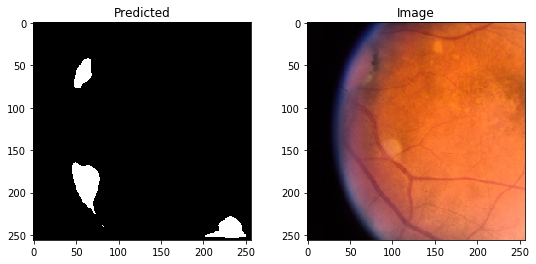

image #77 :  55429_08_F2_LE_RS


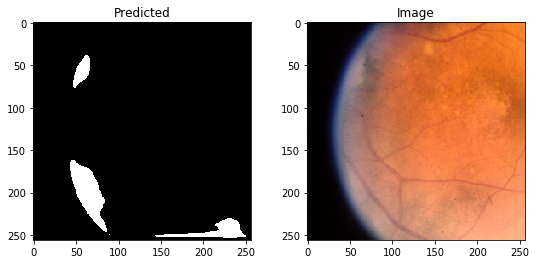

image #78 :  55429_08_F2_RE_LS


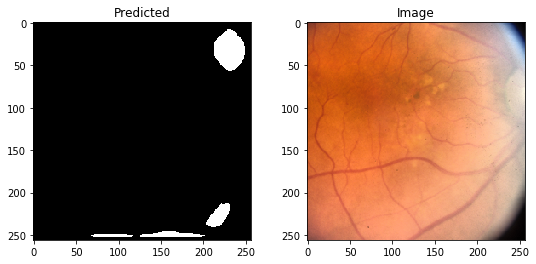

image #79 :  55429_08_F2_RE_RS


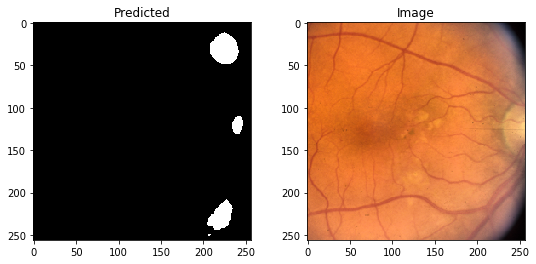

image #80 :  56384_04_F2_LE_LS


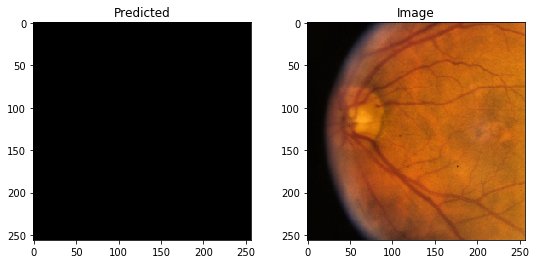

image #81 :  56384_04_F2_LE_RS


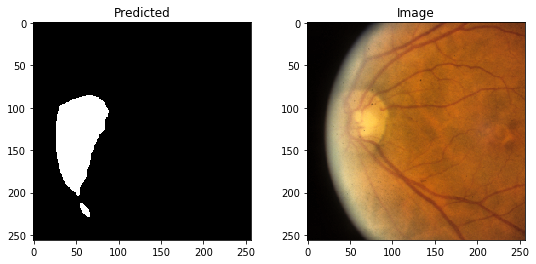

image #82 :  56384_04_F2_RE_LS


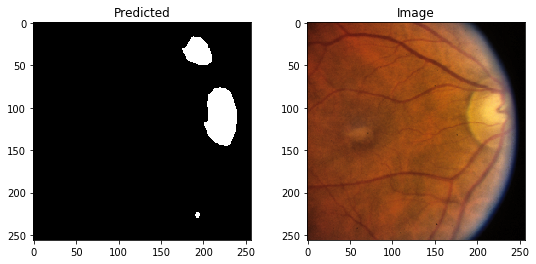

image #83 :  56384_04_F2_RE_RS


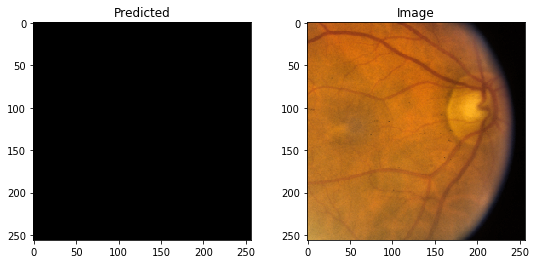

image #84 :  56384_05_F2_LE_LS


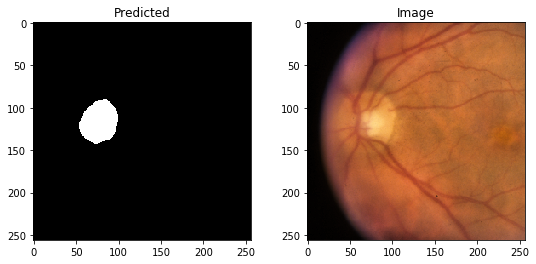

image #85 :  56384_05_F2_LE_RS


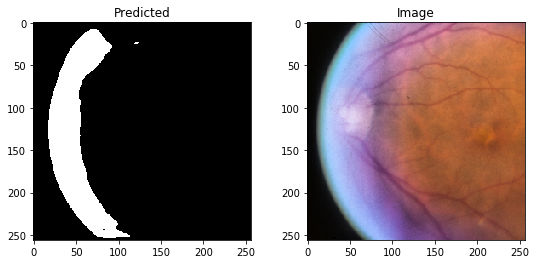

image #86 :  56384_05_F2_RE_LS


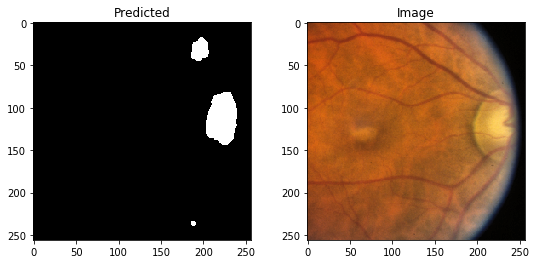

image #87 :  56384_05_F2_RE_RS


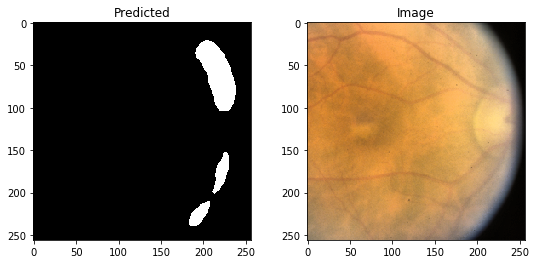

image #88 :  56384_06_F2_LE_LS


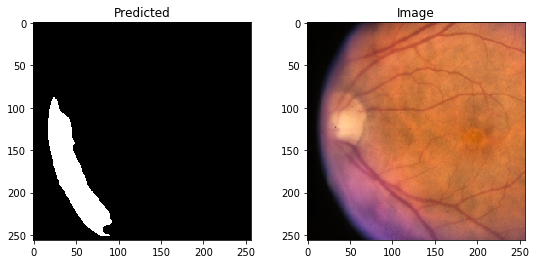

image #89 :  56384_06_F2_LE_RS


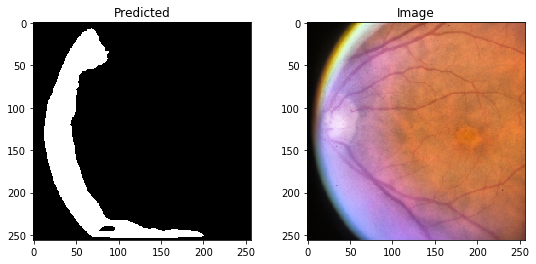

image #90 :  56384_06_F2_RE_LS


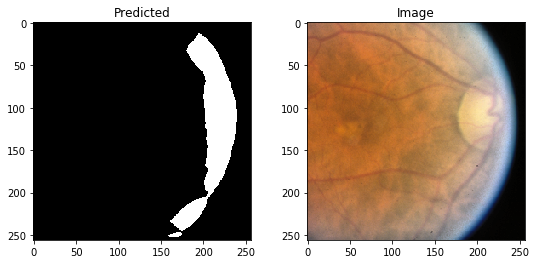

image #91 :  56384_06_F2_RE_RS


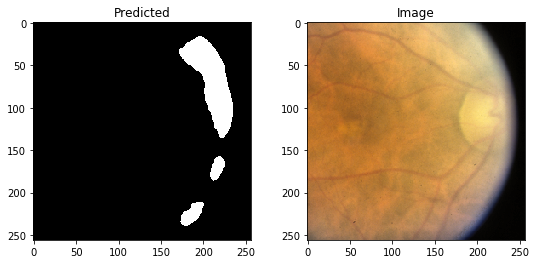

image #92 :  56384_08_F2_LE_LS


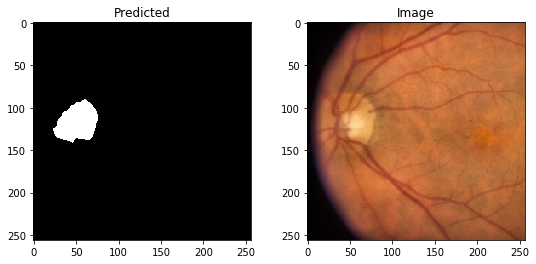

image #93 :  56384_08_F2_LE_RS


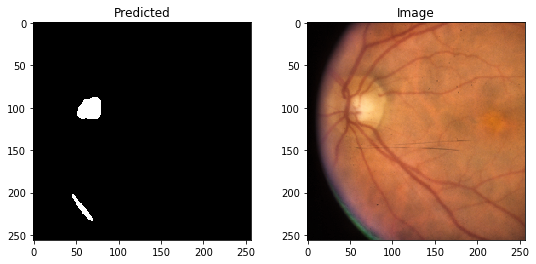

image #94 :  56384_08_F2_RE_LS


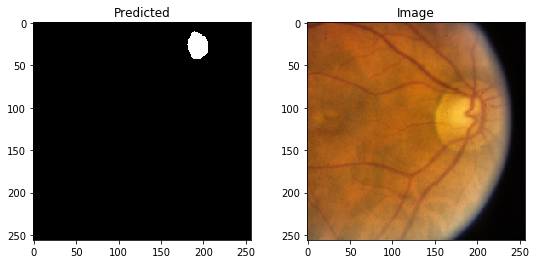

image #95 :  56384_08_F2_RE_RS


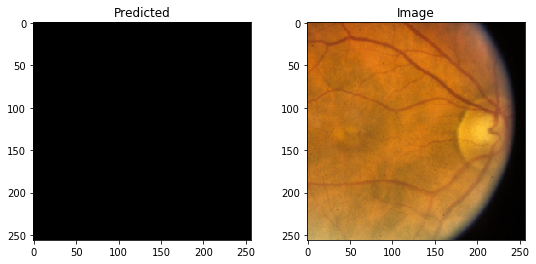

image #96 :  56384_10_F2_LE_LS


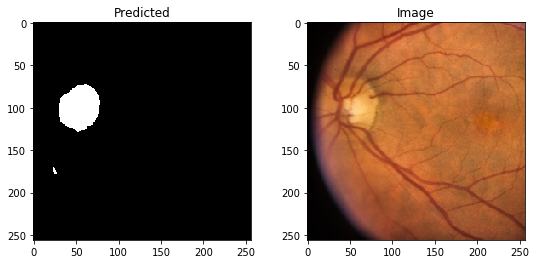

image #97 :  56384_10_F2_LE_RS


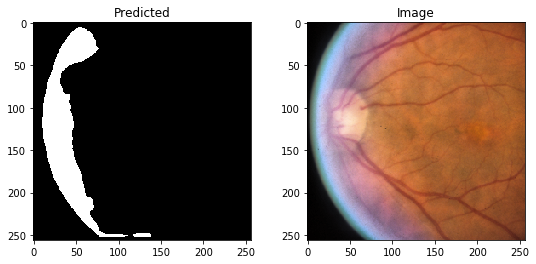

image #98 :  56384_10_F2_RE_LS


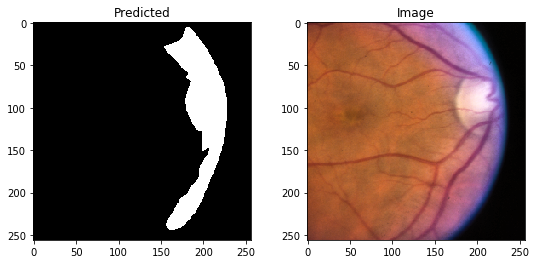

image #99 :  56384_10_F2_RE_RS


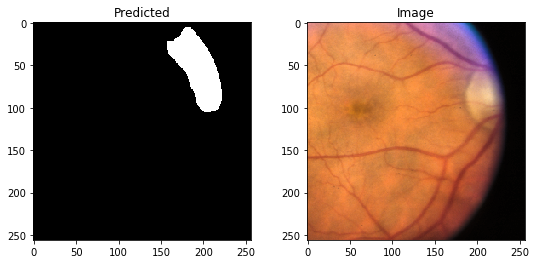

image #100 :  56384_12_F2_LE_LS


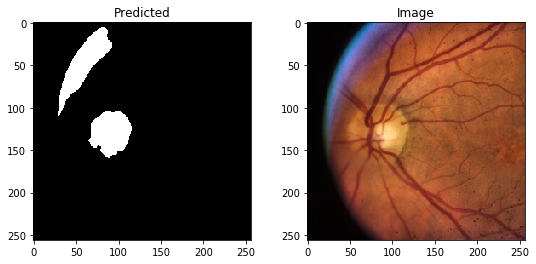

image #101 :  56384_12_F2_LE_RS


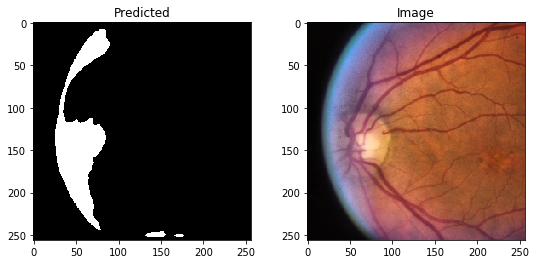

image #102 :  56384_12_F2_RE_LS


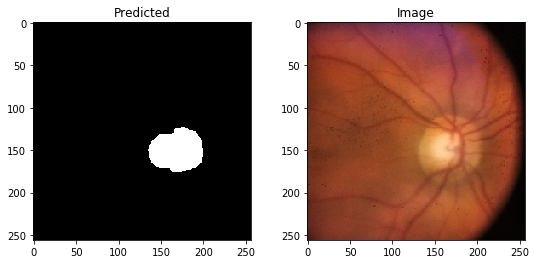

image #103 :  56384_12_F2_RE_RS


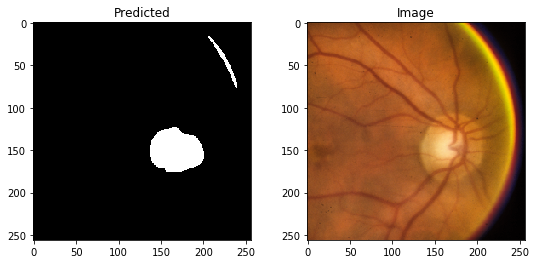

image #104 :  56384_14_F2_LE_LS


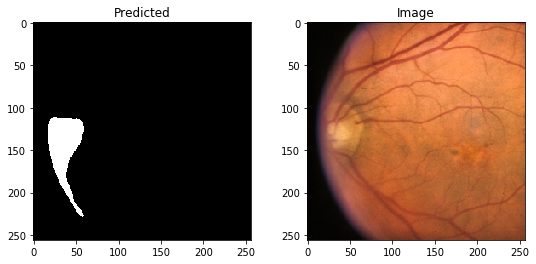

image #105 :  56384_14_F2_LE_RS


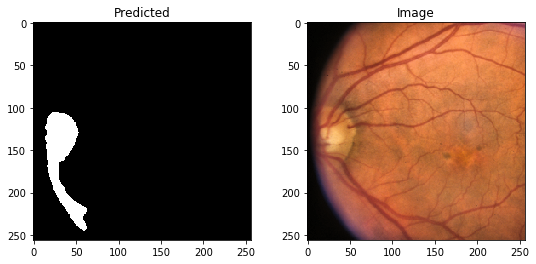

image #106 :  56384_14_F2_RE_LS


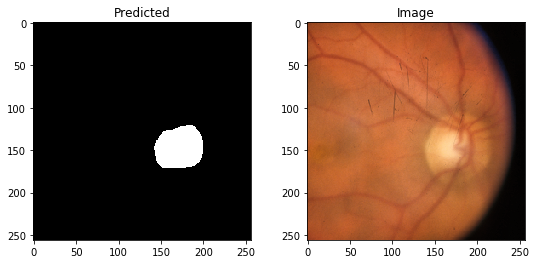

image #107 :  56384_14_F2_RE_RS


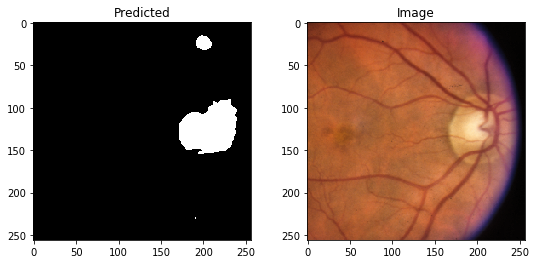

image #108 :  56384_22_F2_LE_LS


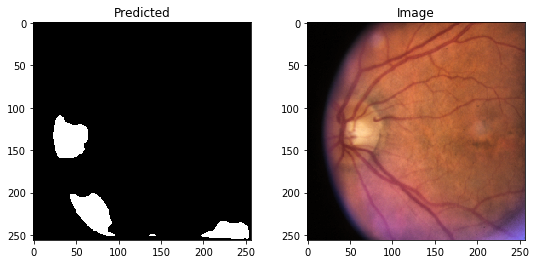

image #109 :  56384_22_F2_LE_RS


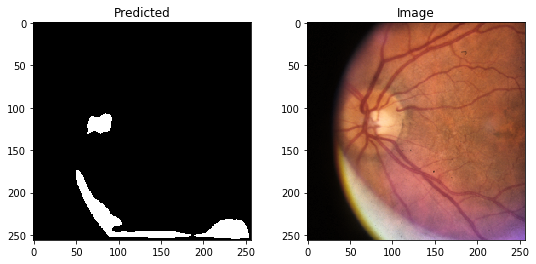

image #110 :  56384_22_F2_RE_LS


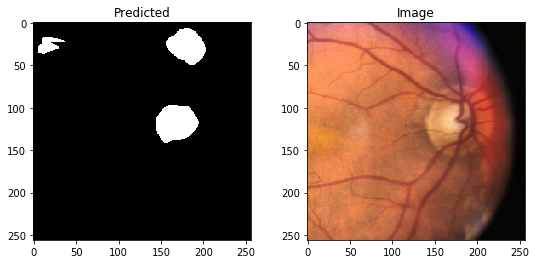

image #111 :  56384_22_F2_RE_RS


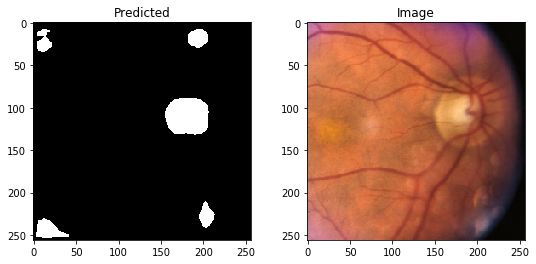

image #112 :  56400_04_F2_LE_LS


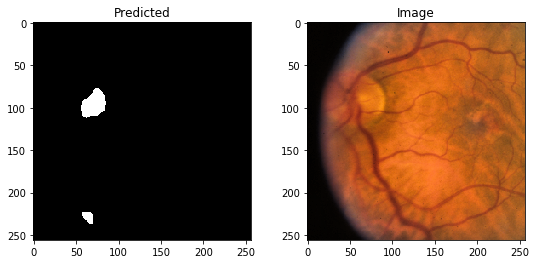

image #113 :  56400_04_F2_LE_RS


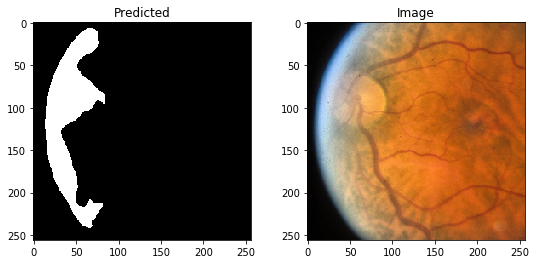

image #114 :  56400_04_F2_RE_LS


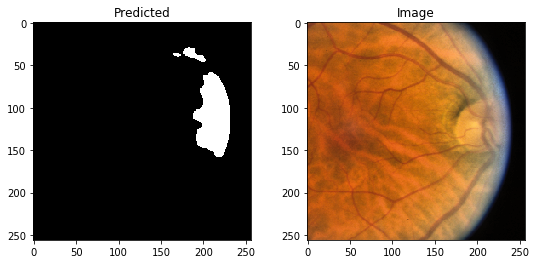

image #115 :  56400_04_F2_RE_RS


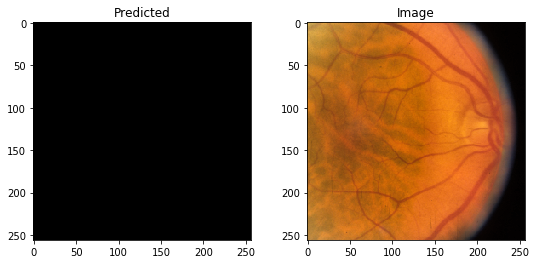

image #116 :  56400_06_F2_LE_LS


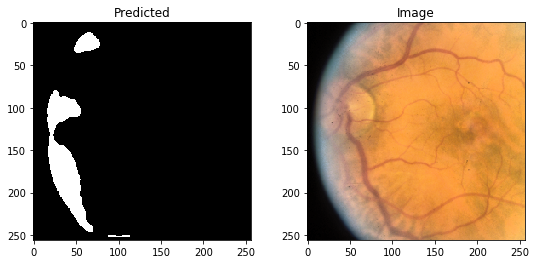

image #117 :  56400_06_F2_LE_RS


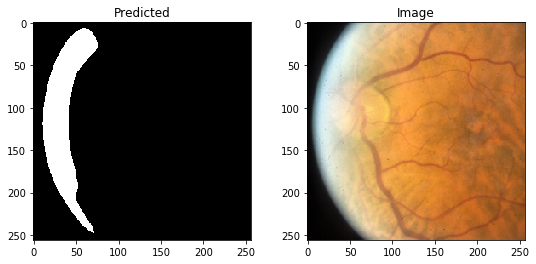

image #118 :  56400_06_F2_RE_LS


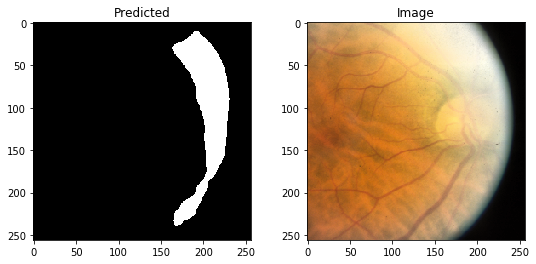

image #119 :  56400_06_F2_RE_RS


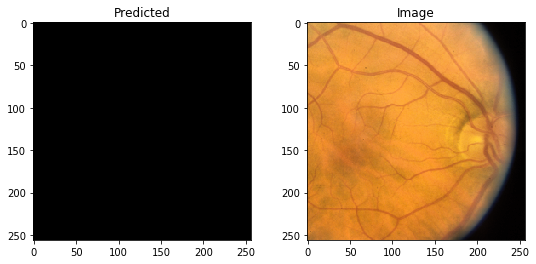

image #120 :  56400_08_F2_LE_LS


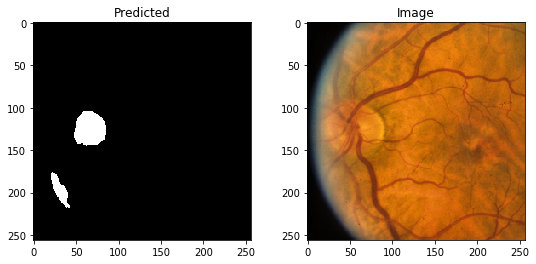

image #121 :  56400_08_F2_LE_RS


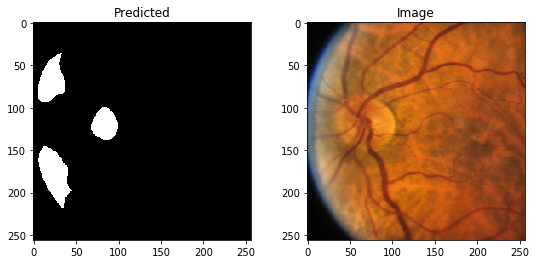

image #122 :  56400_08_F2_RE_LS


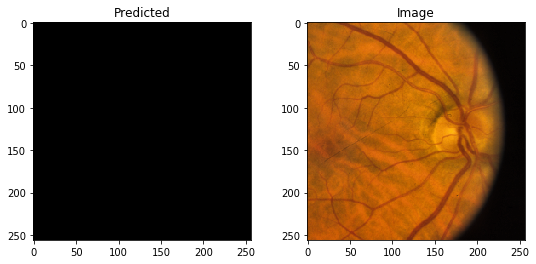

image #123 :  56400_08_F2_RE_RS


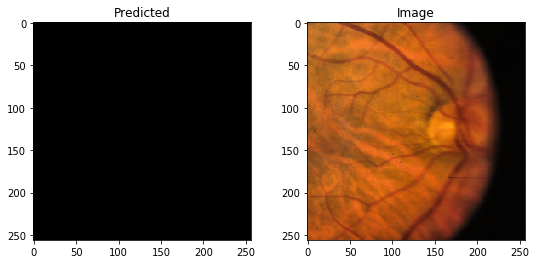

image #124 :  56400_10_F2_LE_LS


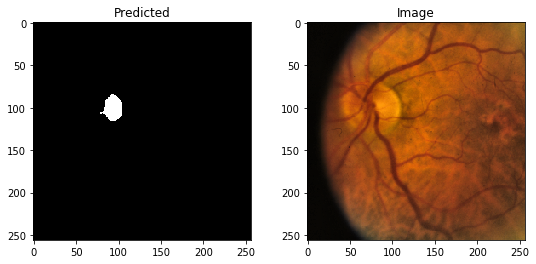

image #125 :  56400_10_F2_LE_RS


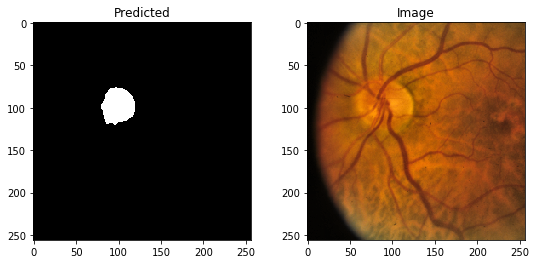

image #126 :  56400_10_F2_RE_LS


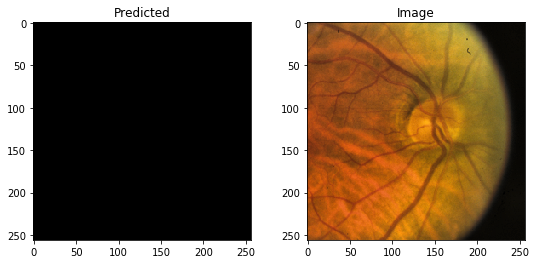

image #127 :  56400_10_F2_RE_RS


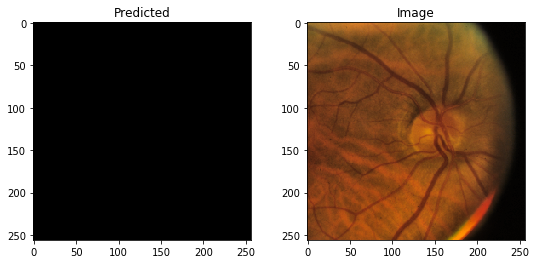

image #128 :  56400_12_F2_LE_LS


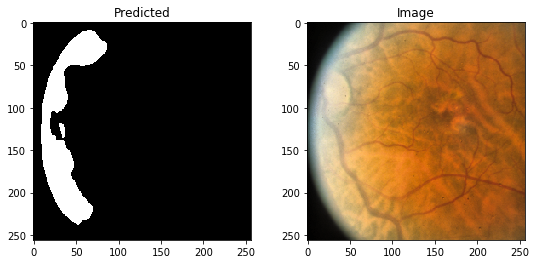

image #129 :  56400_12_F2_LE_RS


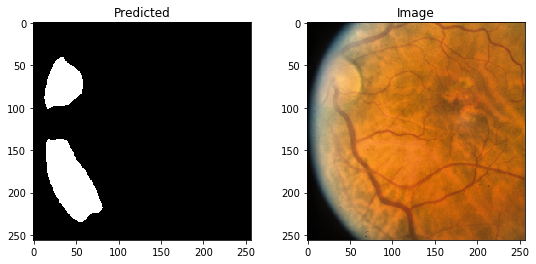

image #130 :  56400_12_F2_RE_LS


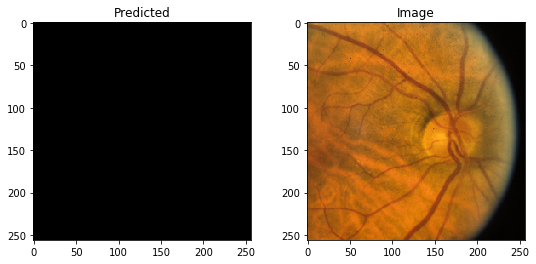

image #131 :  56400_12_F2_RE_RS


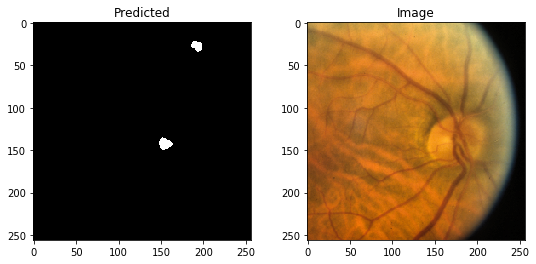

image #132 :  56400_14_F2_LE_LS


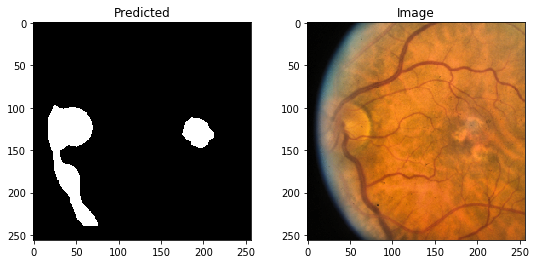

image #133 :  56400_14_F2_LE_RS


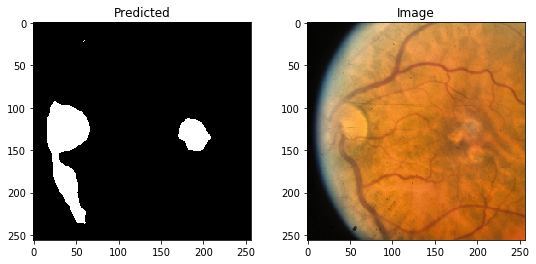

image #134 :  56400_14_F2_RE_LS


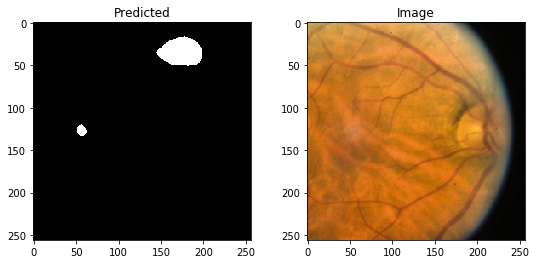

image #135 :  56400_14_F2_RE_RS


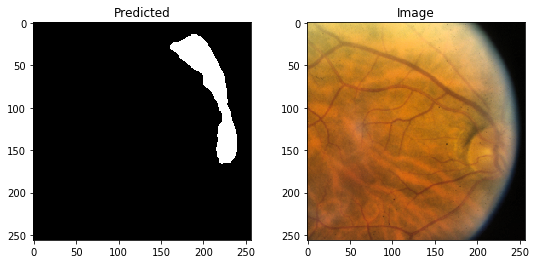

image #136 :  56400_16_F2_LE_LS


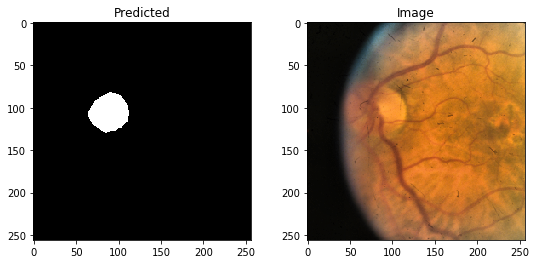

image #137 :  56400_16_F2_LE_RS


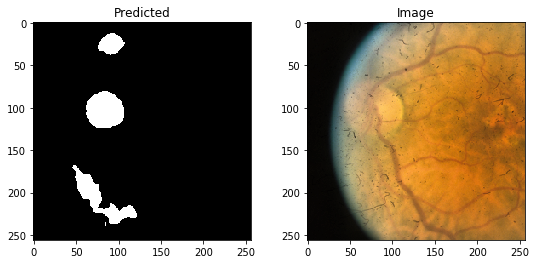

image #138 :  56400_16_F2_RE_LS


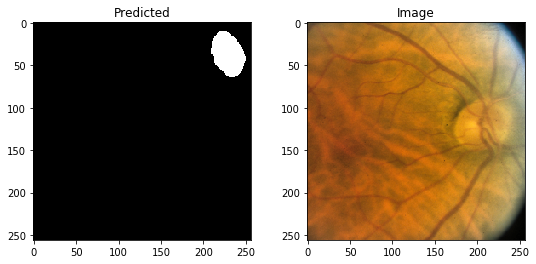

image #139 :  56400_16_F2_RE_RS


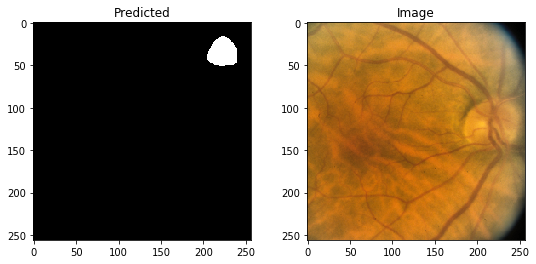

image #140 :  56400_18_F2_LE_LS


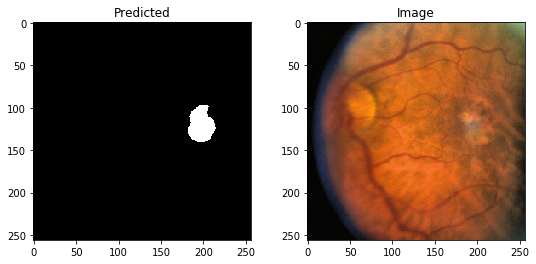

image #141 :  56400_18_F2_LE_RS


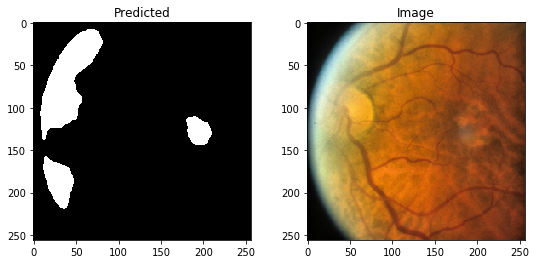

image #142 :  56400_18_F2_RE_LS


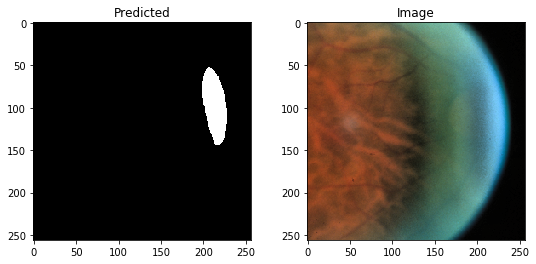

image #143 :  56400_18_F2_RE_RS


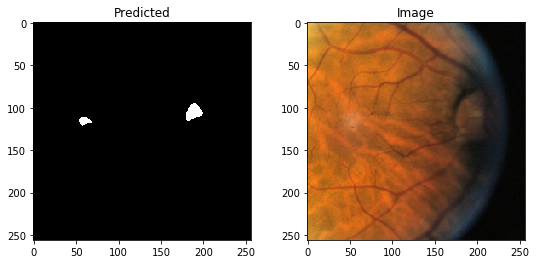

image #144 :  56400_20_F2_LE_LS


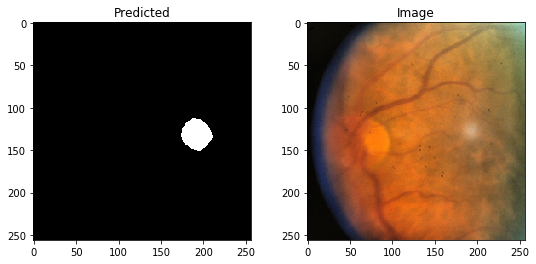

image #145 :  56400_20_F2_LE_RS


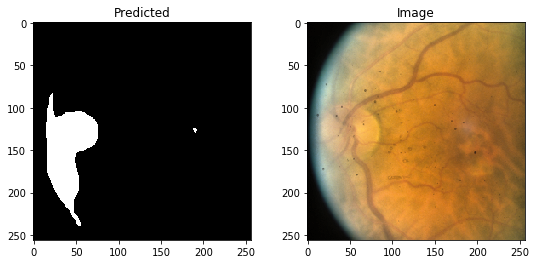

image #146 :  56400_20_F2_RE_LS


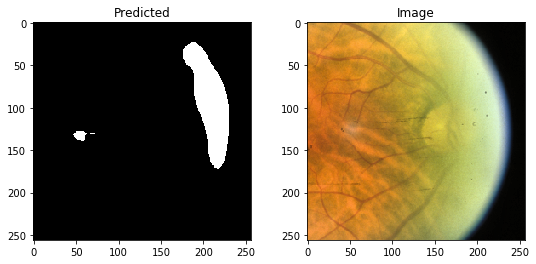

image #147 :  56400_20_F2_RE_RS


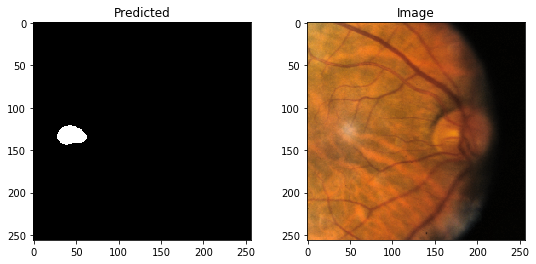

image #148 :  56400_22_F2_LE_LS


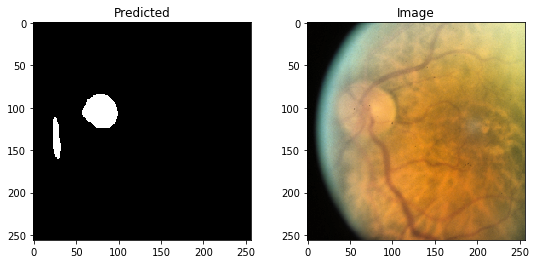

image #149 :  56400_22_F2_LE_RS


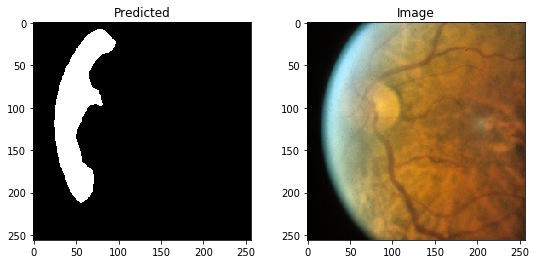

image #150 :  56400_22_F2_RE_LS


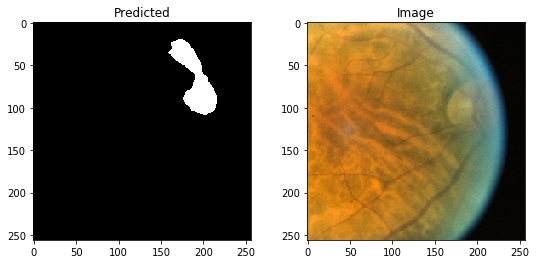

image #151 :  56400_22_F2_RE_RS


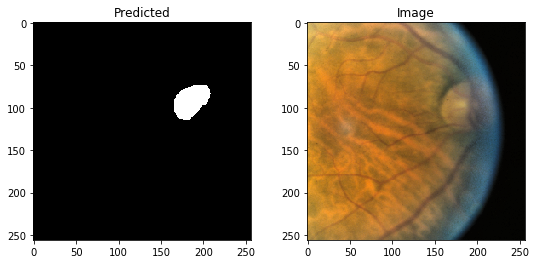

image #152 :  56435_04_F2_LE_LS


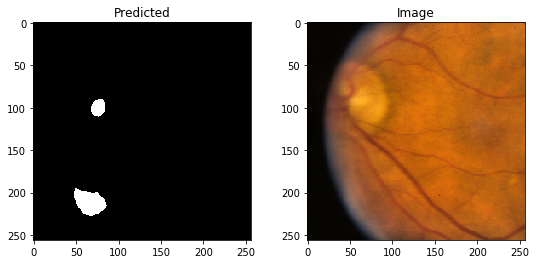

image #153 :  56435_04_F2_LE_RS


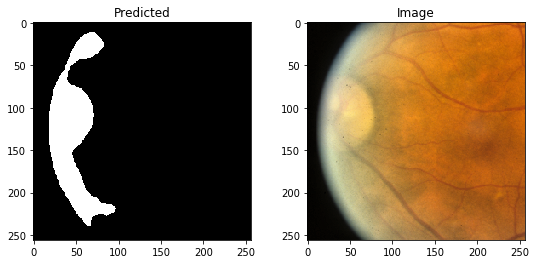

image #154 :  56435_04_F2_RE_LS


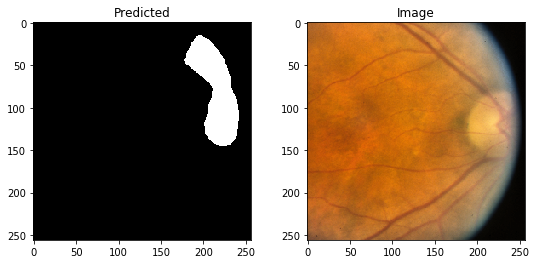

image #155 :  56435_04_F2_RE_RS


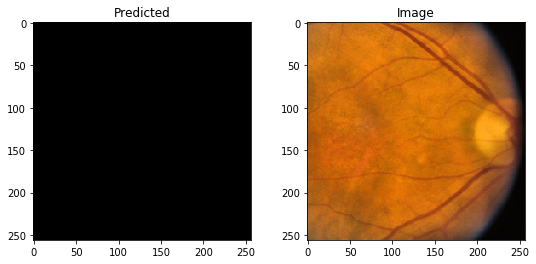

image #156 :  56435_06_F2_LE_LS


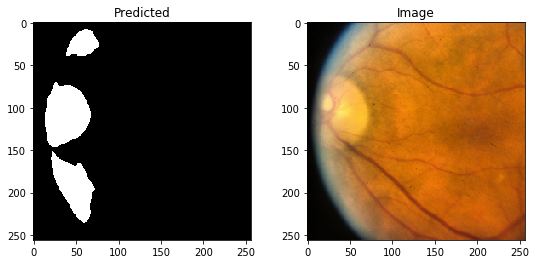

image #157 :  56435_06_F2_LE_RS


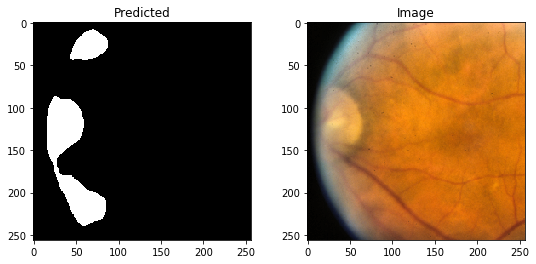

image #158 :  56435_06_F2_RE_LS


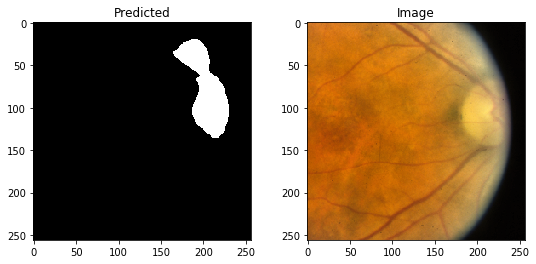

image #159 :  56435_06_F2_RE_RS


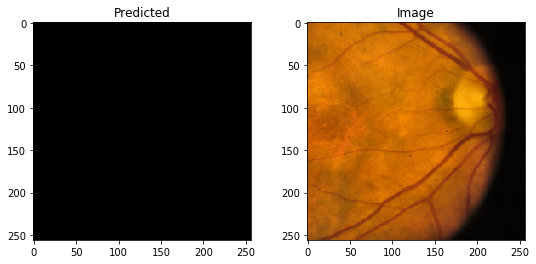

image #160 :  56435_08_F2_LE_LS


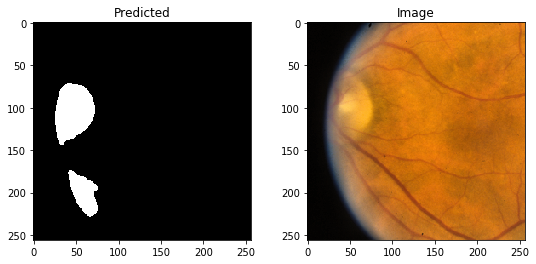

image #161 :  56435_08_F2_LE_RS


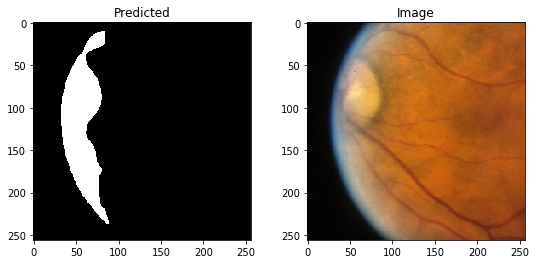

image #162 :  56435_08_F2_RE_LS


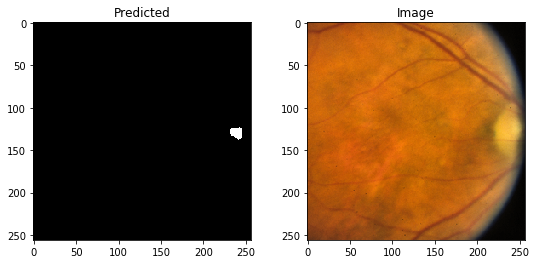

image #163 :  56435_08_F2_RE_RS


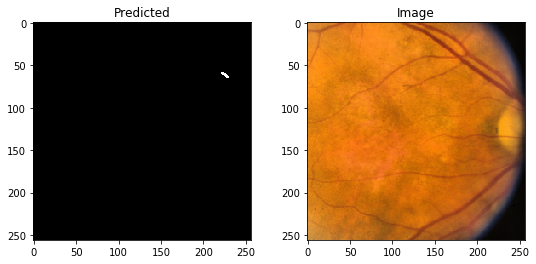

image #164 :  56435_10_F2_LE_LS


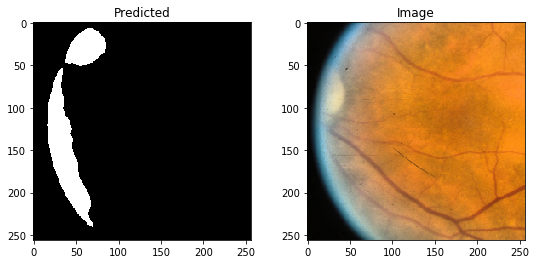

image #165 :  56435_10_F2_LE_RS


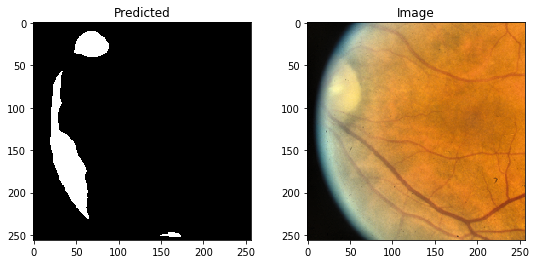

image #166 :  56435_10_F2_RE_LS


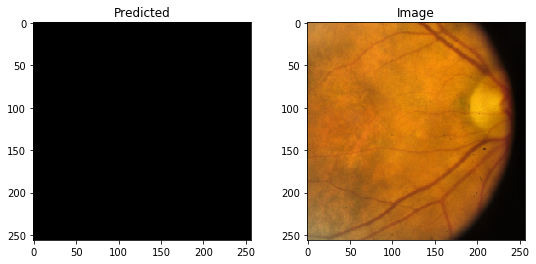

image #167 :  56435_10_F2_RE_RS


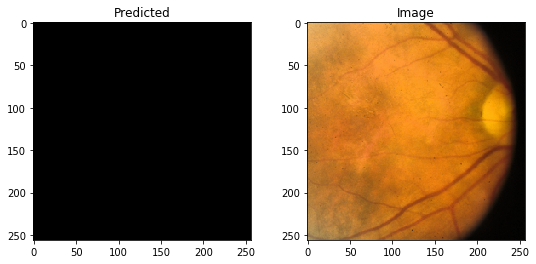

image #168 :  56435_12_F2_LE_LS


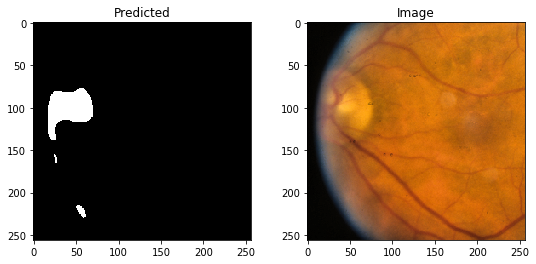

image #169 :  56435_12_F2_LE_RS


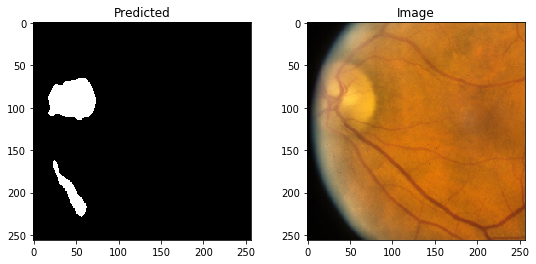

image #170 :  56435_12_F2_RE_LS


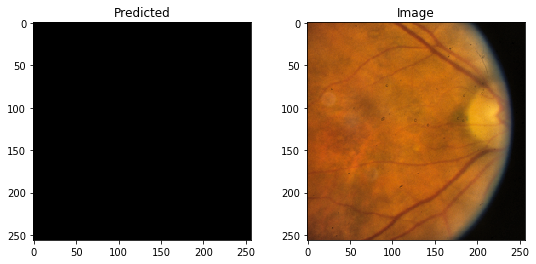

image #171 :  56435_12_F2_RE_RS


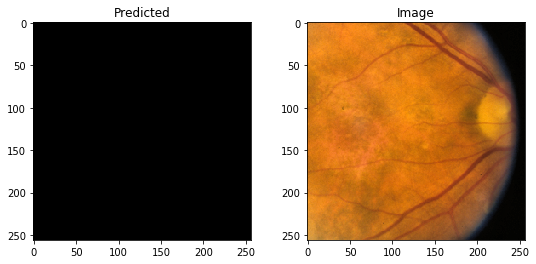

image #172 :  58799_04_F2_LE_LS


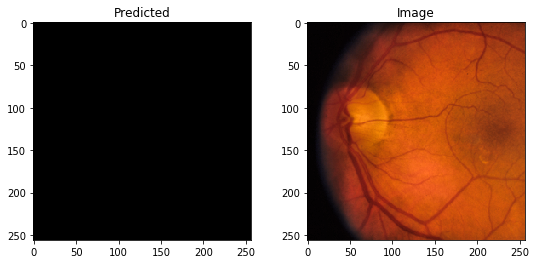

image #173 :  58799_04_F2_LE_RS


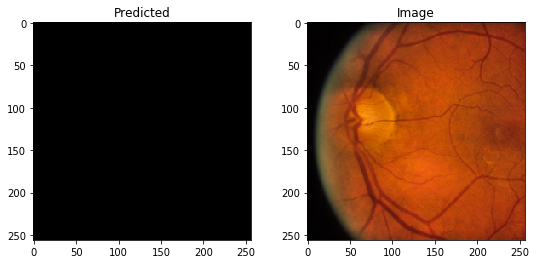

image #174 :  58799_04_F2_RE_LS


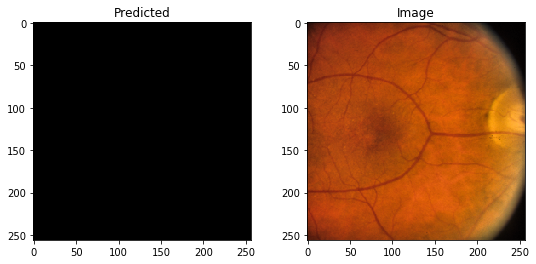

image #175 :  58799_04_F2_RE_RS


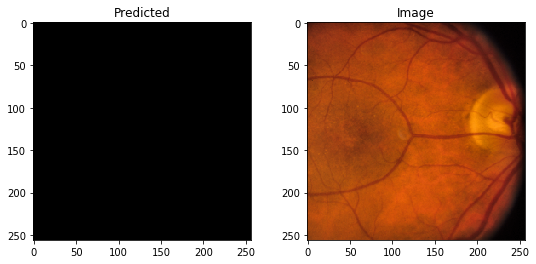

image #176 :  58799_06_F2_LE_LS


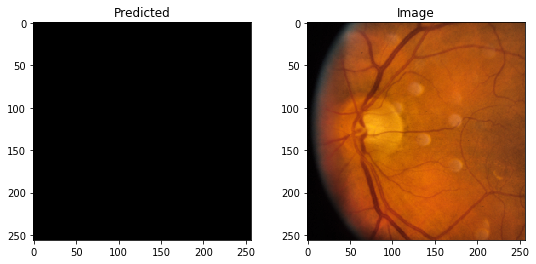

image #177 :  58799_06_F2_LE_RS


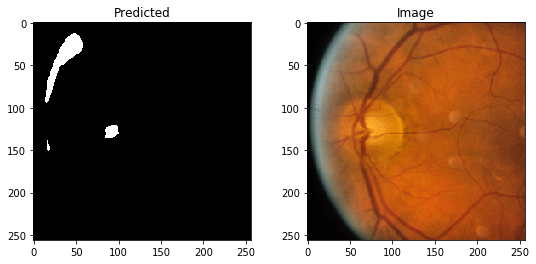

image #178 :  58799_06_F2_RE_LS


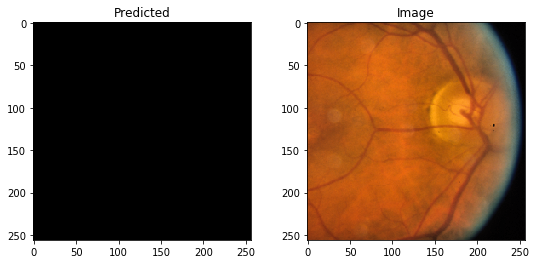

image #179 :  58799_06_F2_RE_RS


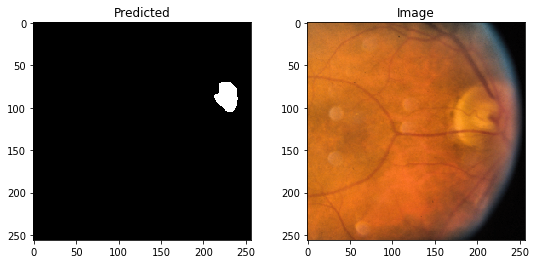

image #180 :  58799_08_F2_LE_LS


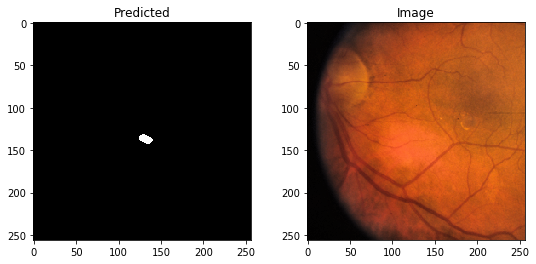

image #181 :  58799_08_F2_LE_RS


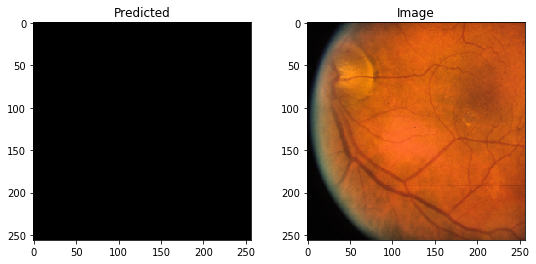

image #182 :  58799_08_F2_RE_LS


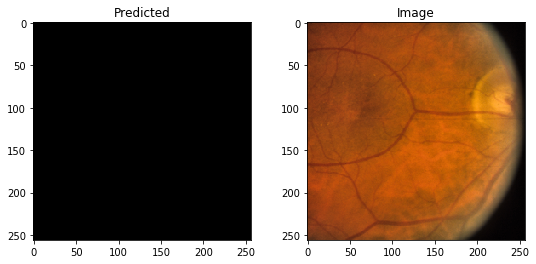

image #183 :  58799_08_F2_RE_RS


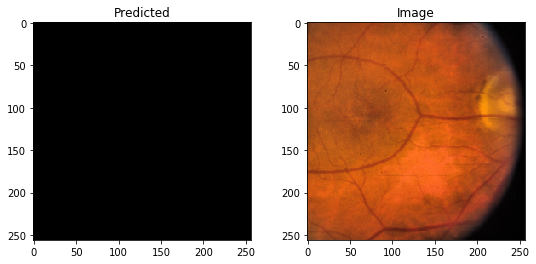

image #184 :  58799_10_F2_LE_LS


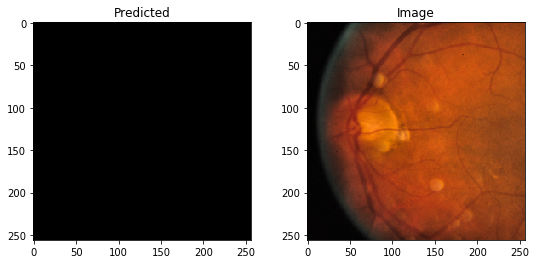

image #185 :  58799_10_F2_LE_RS


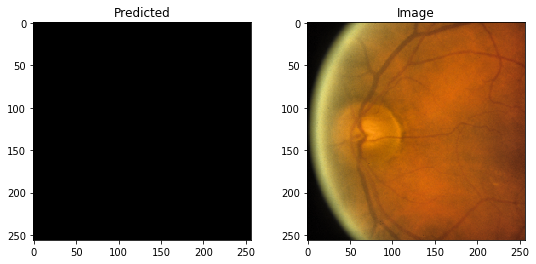

image #186 :  58799_10_F2_RE_LS


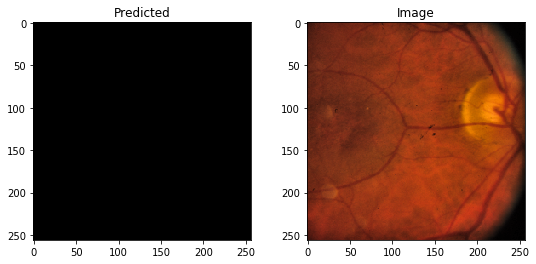

image #187 :  58799_10_F2_RE_RS


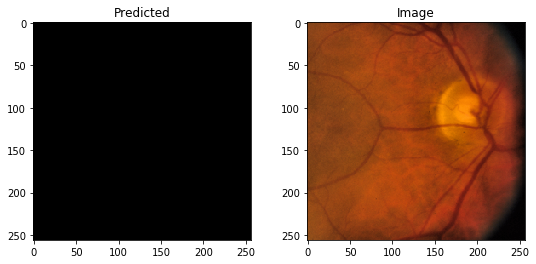

image #188 :  58799_12_F2_LE_LS


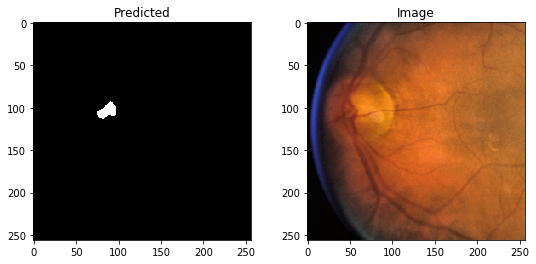

image #189 :  58799_12_F2_LE_RS


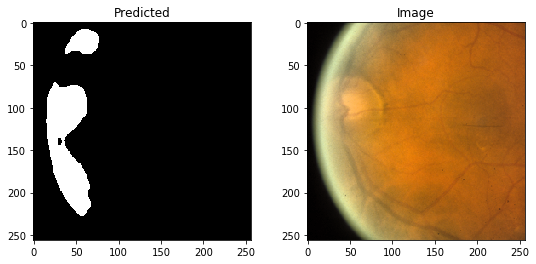

image #190 :  58799_12_F2_RE_LS


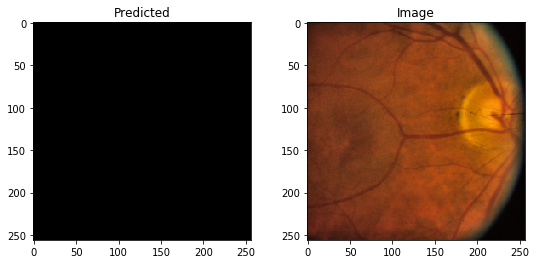

image #191 :  58799_12_F2_RE_RS


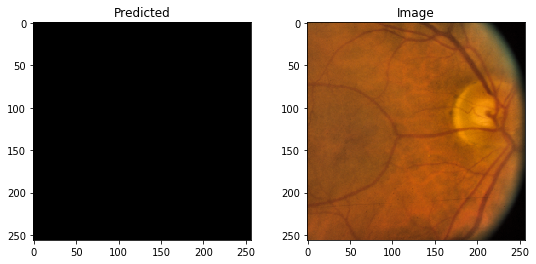

image #192 :  58799_18_F2_LE_LS


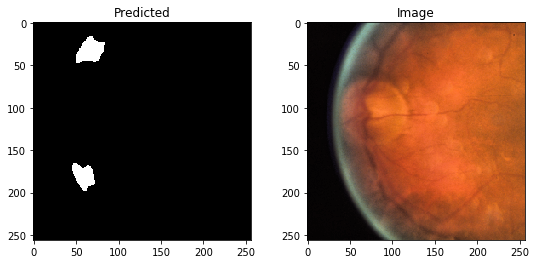

image #193 :  58799_18_F2_LE_RS


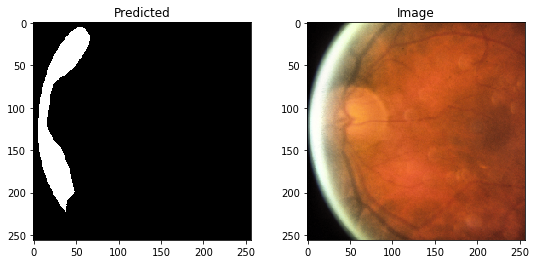

image #194 :  58799_18_F2_RE_LS


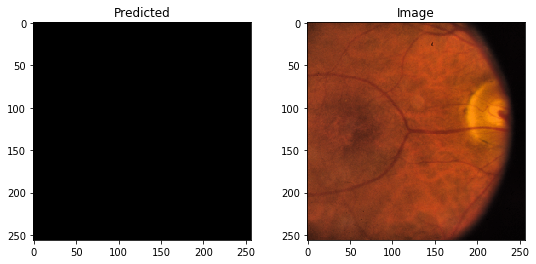

image #195 :  58799_18_F2_RE_RS


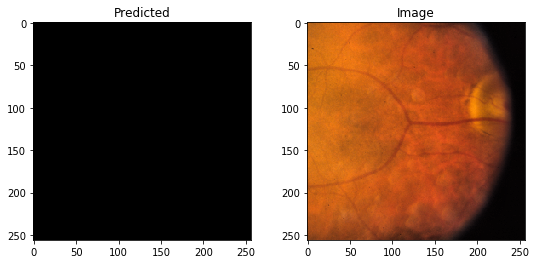

image #196 :  58799_20_F2_LE_LS


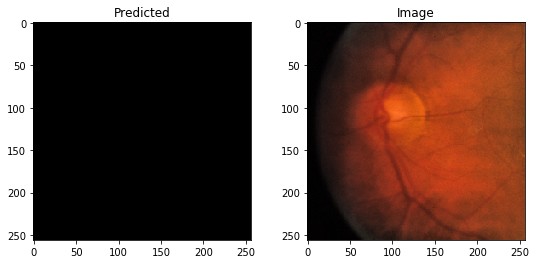

image #197 :  58799_20_F2_LE_RS


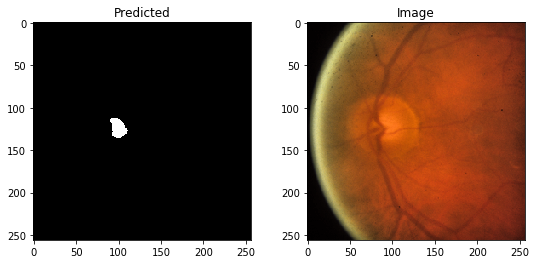

image #198 :  58799_20_F2_RE_LS


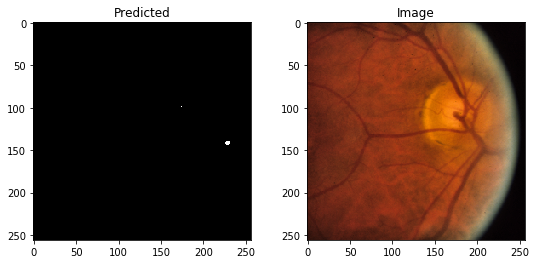

image #199 :  58799_20_F2_RE_RS


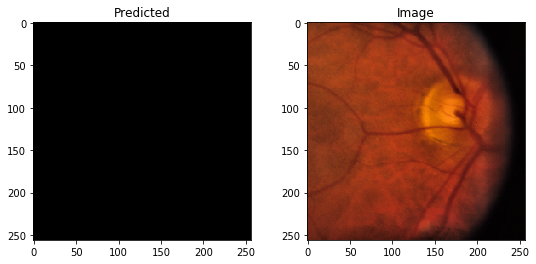

image #200 :  60326_04_F2_LE_RS


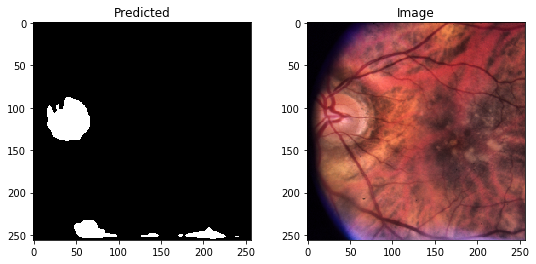

image #201 :  60326_04_F2_LE_lS


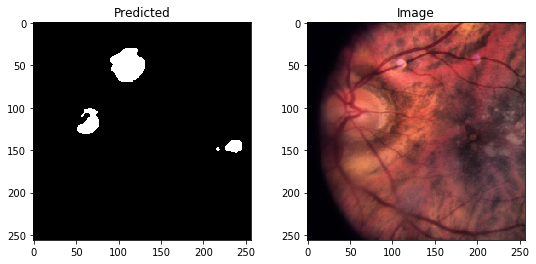

image #202 :  60326_04_F2_RE_LS


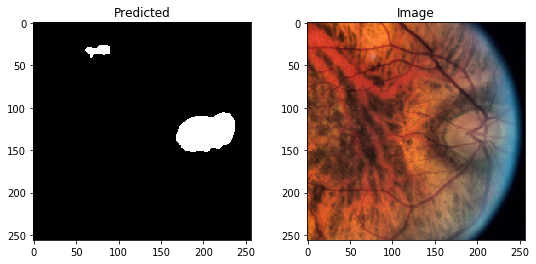

image #203 :  60326_04_F2_RE_RS


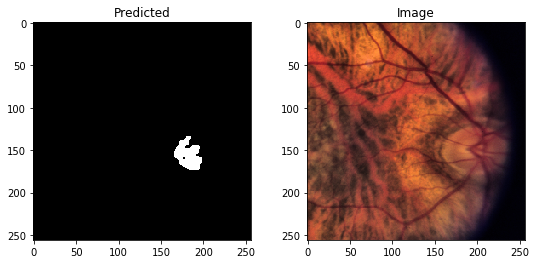

image #204 :  60326_06_F2_LE_LS


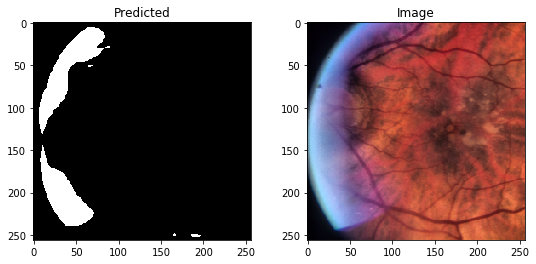

image #205 :  60326_06_F2_LE_RS


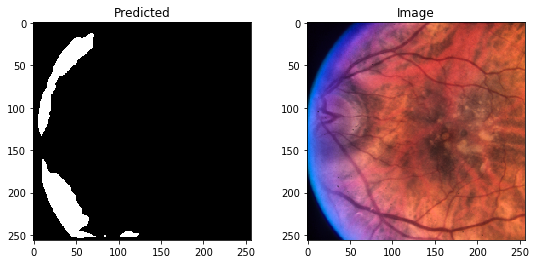

image #206 :  60326_06_F2_RE_LS


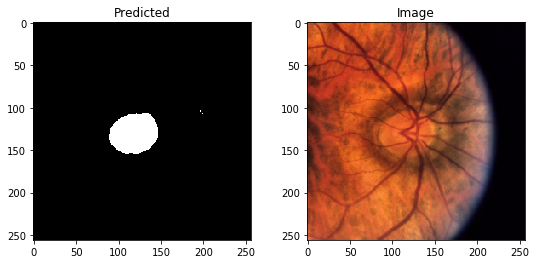

image #207 :  60326_06_F2_RE_RS


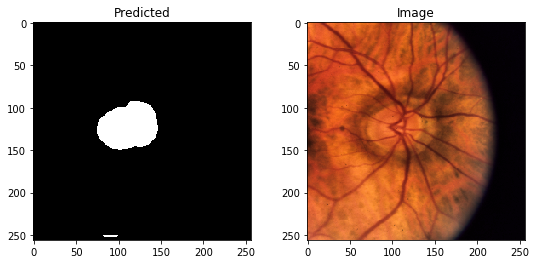

image #208 :  60326_08_F2_LE_LS


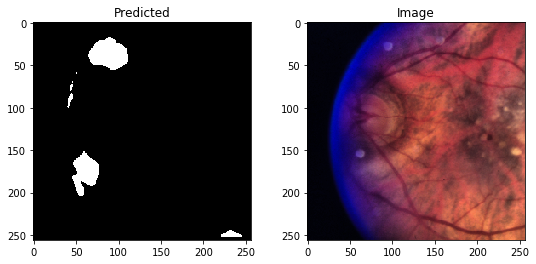

image #209 :  60326_08_F2_LE_RS


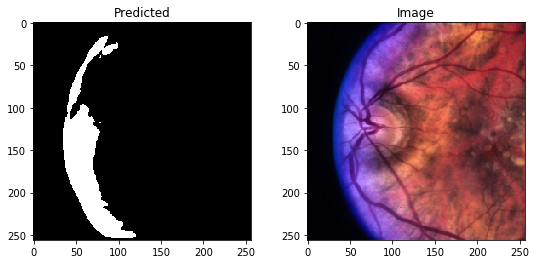

image #210 :  60326_08_F2_RE_LS


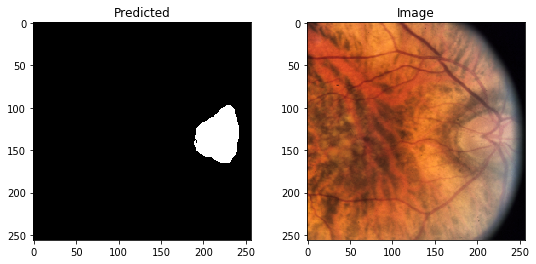

image #211 :  60326_08_F2_RE_RS


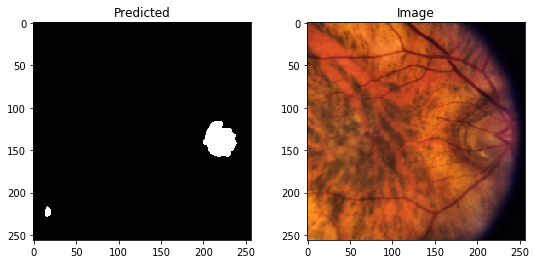

image #212 :  60326_10_F2_LE_LS


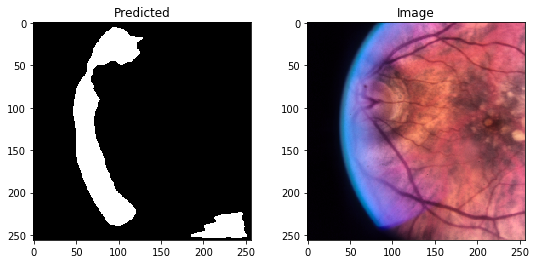

image #213 :  60326_10_F2_LE_RS


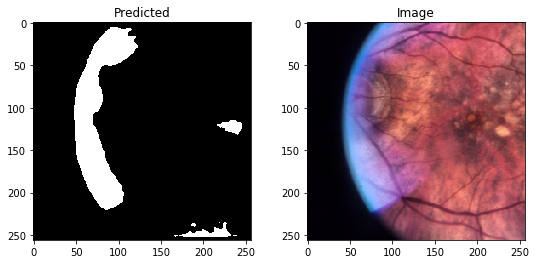

image #214 :  60326_10_F2_RE_LS


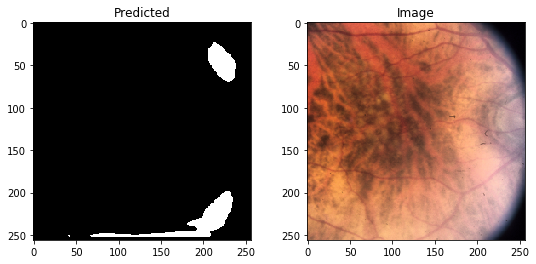

image #215 :  60326_10_F2_RE_RS


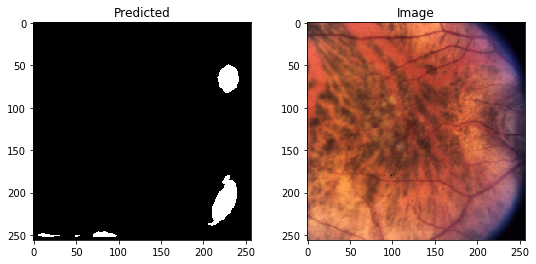

image #216 :  60326_12_F2_LE_LS


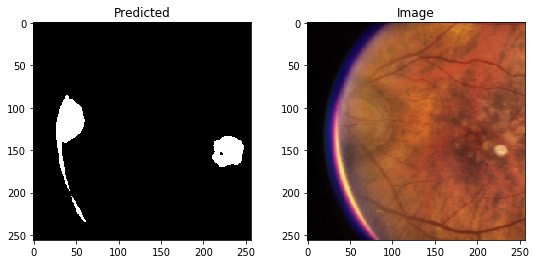

image #217 :  60326_12_F2_LE_RS


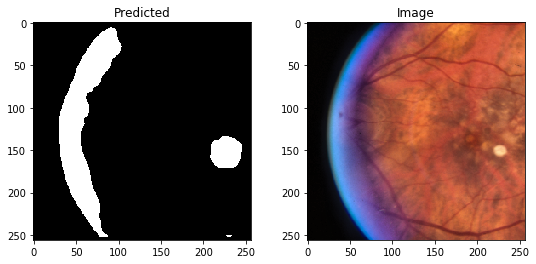

image #218 :  60326_12_F2_RE_LS


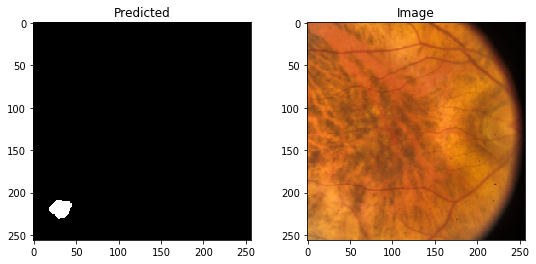

image #219 :  60326_12_F2_RE_RS


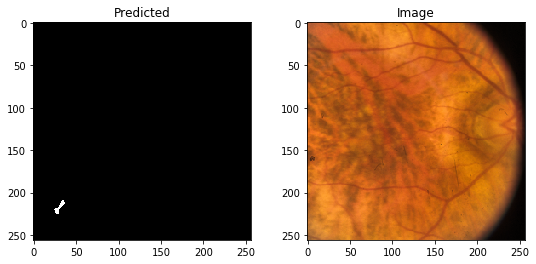

image #220 :  60326_16_F2_LE_LS


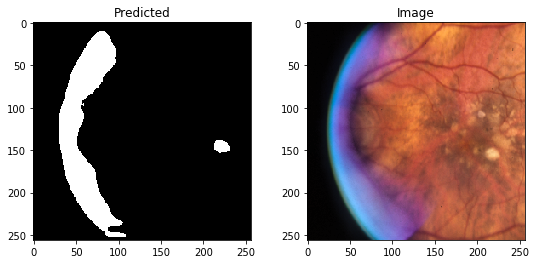

image #221 :  60326_16_F2_LE_RS


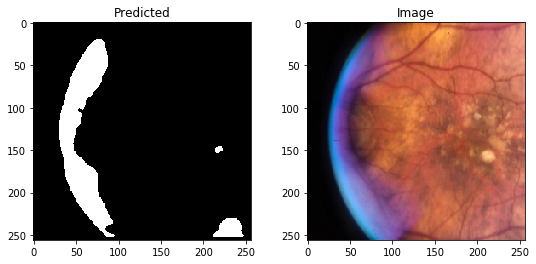

image #222 :  60326_16_F2_RE_LS


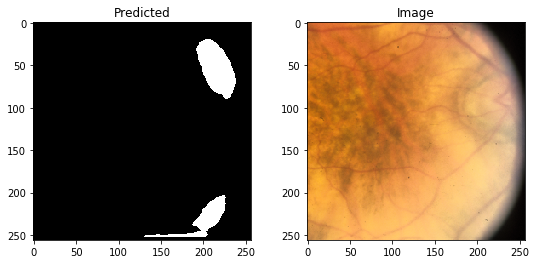

image #223 :  60326_16_F2_RE_RS


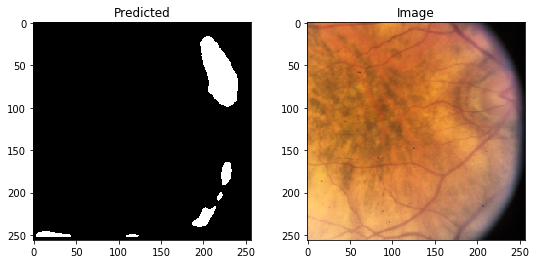

image #224 :  60326_18_F2_LE_LS


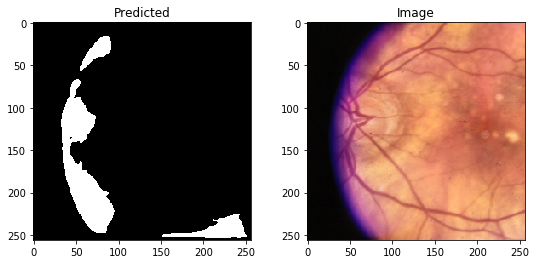

image #225 :  60326_18_F2_LE_RS


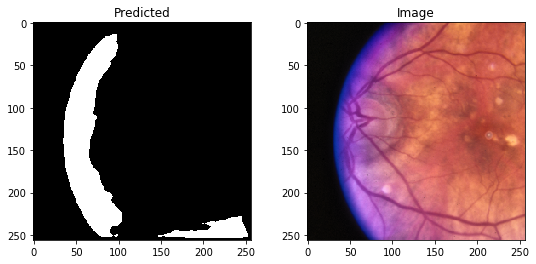

image #226 :  60326_18_F2_RE_LS


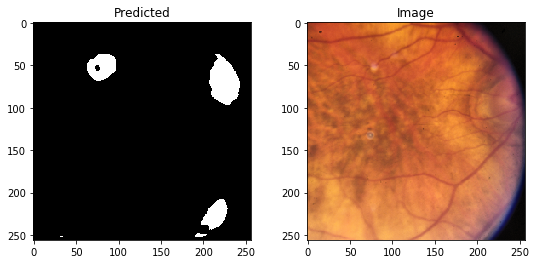

image #227 :  60326_18_F2_RE_RS


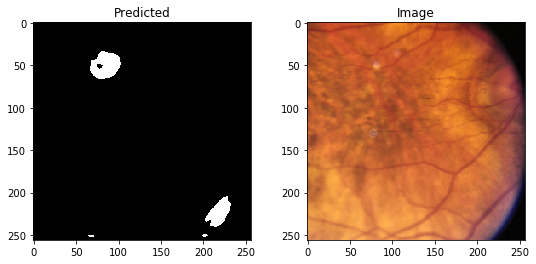

image #228 :  60326_20_F2_LE_LS


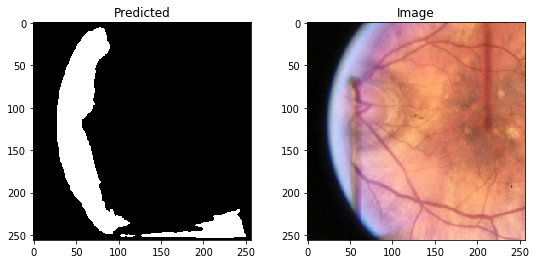

image #229 :  60326_20_F2_LE_RS


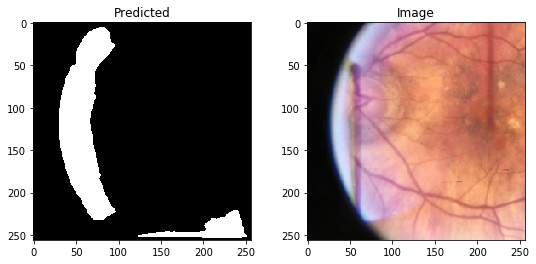

image #230 :  60326_20_F2_RE_LS


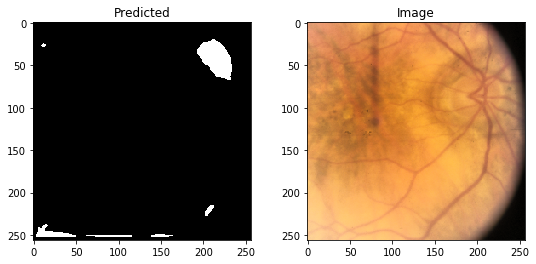

image #231 :  60326_20_F2_RE_RS


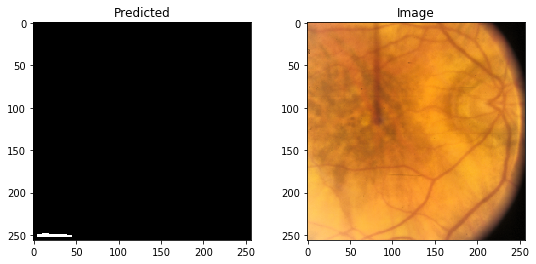

image #232 :  60326_22_F2_LE_LS


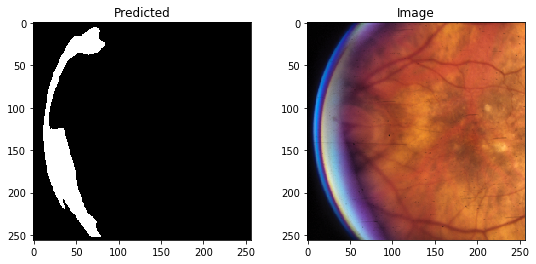

image #233 :  60326_22_F2_LE_RS


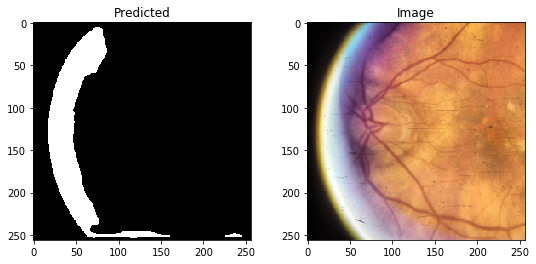

image #234 :  60326_22_F2_RE_LS


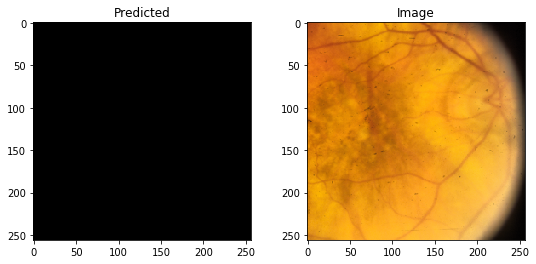

image #235 :  60326_22_F2_RE_RS


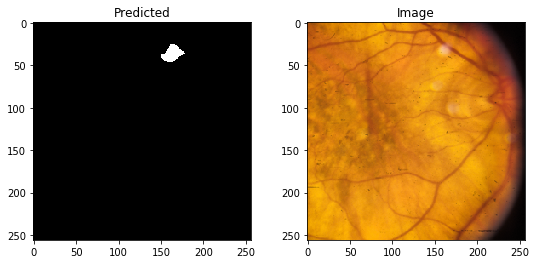

image #236 :  61481_04_F2_LE_LS


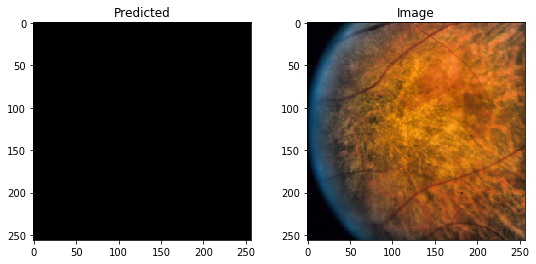

image #237 :  61481_04_F2_LE_RS


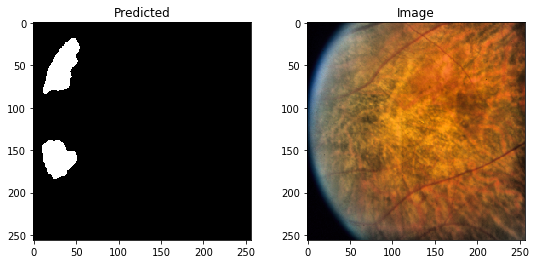

image #238 :  61481_04_F2_RE_LS


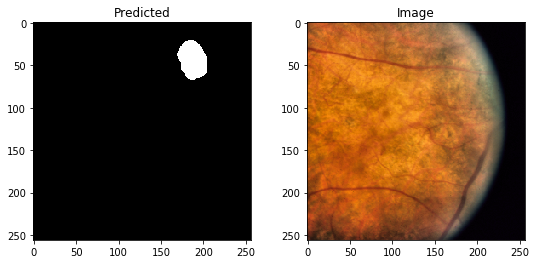

image #239 :  61481_04_F2_RE_RS


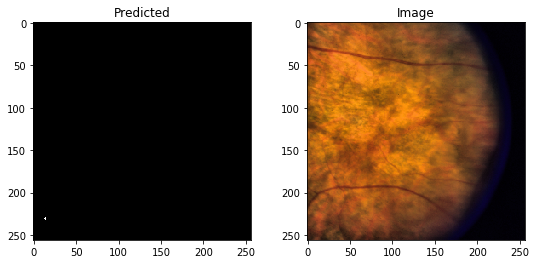

image #240 :  61481_06_F2_LE_LS


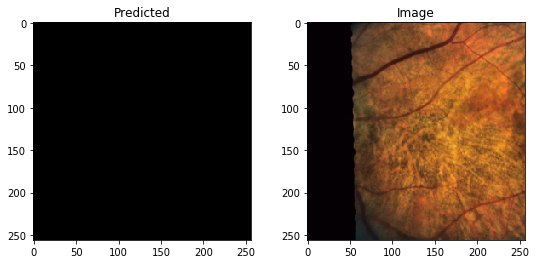

image #241 :  61481_06_F2_LE_RS


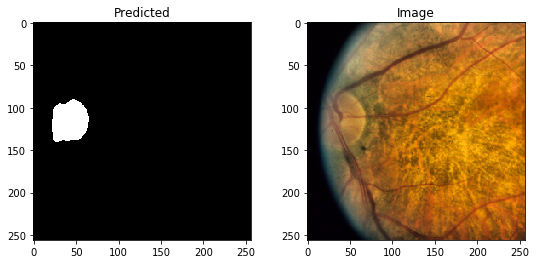

image #242 :  61481_06_F2_RE_LS


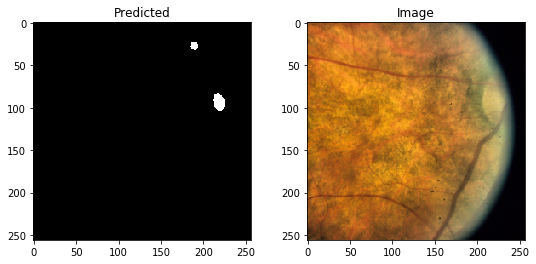

image #243 :  61481_06_F2_RE_RS


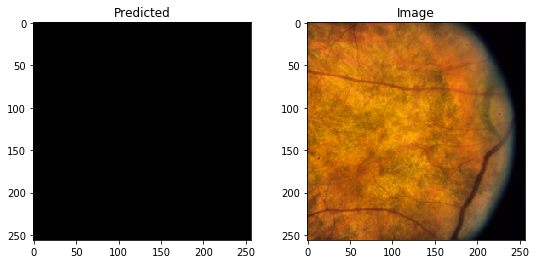

image #244 :  61481_08_F2_LE_LS


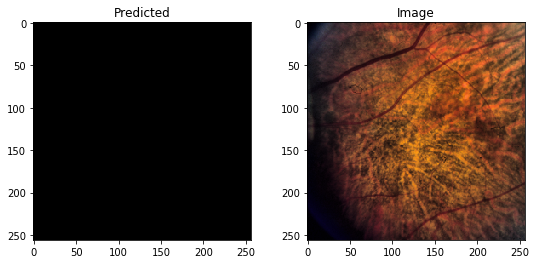

image #245 :  61481_08_F2_LE_RS


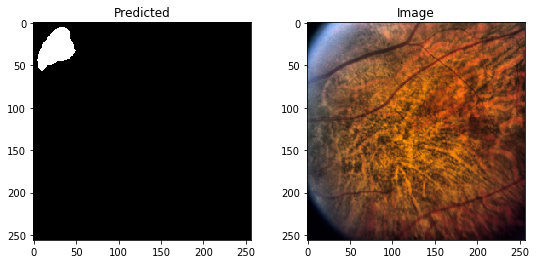

image #246 :  61481_08_F2_RE_LS


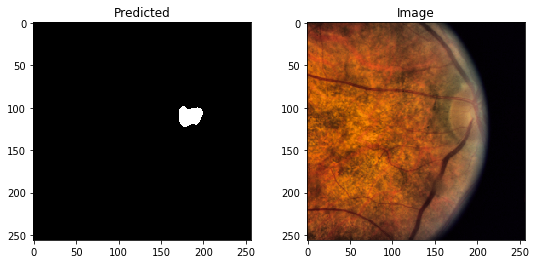

image #247 :  61481_08_F2_RE_RS


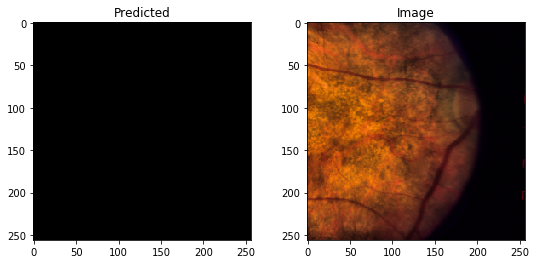

image #248 :  61481_10_F2_LE_LS


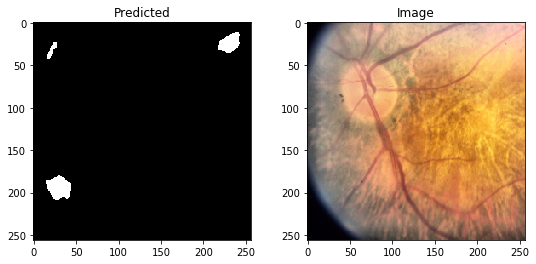

image #249 :  61481_10_F2_LE_RS


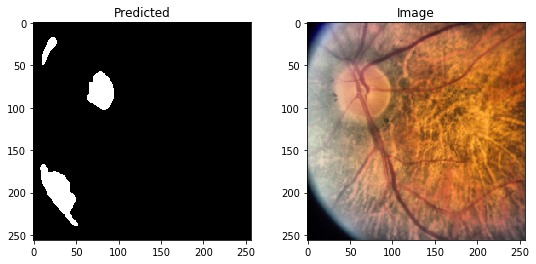

image #250 :  61481_10_F2_RE_LS


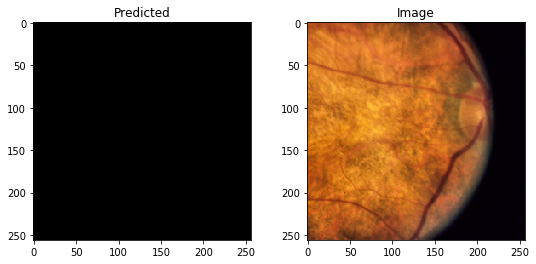

image #251 :  61481_10_F2_RE_RS


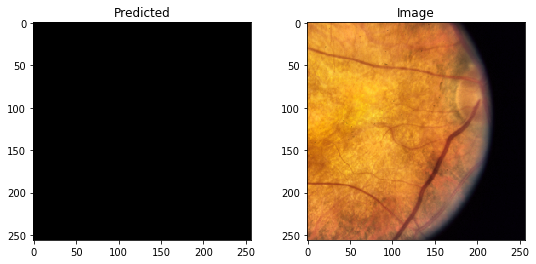

image #252 :  61481_12_F2_LE_LS


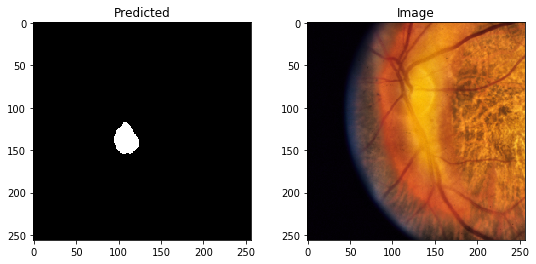

image #253 :  61481_12_F2_LE_RS


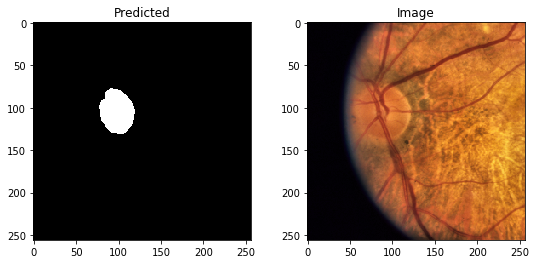

image #254 :  61481_12_F2_RE_LS


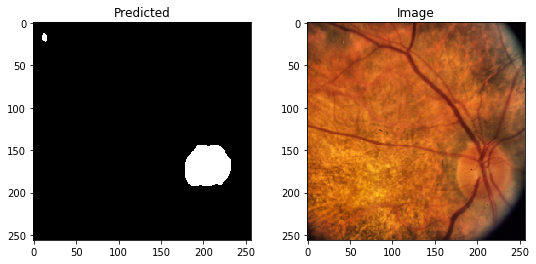

image #255 :  61481_12_F2_RE_RS


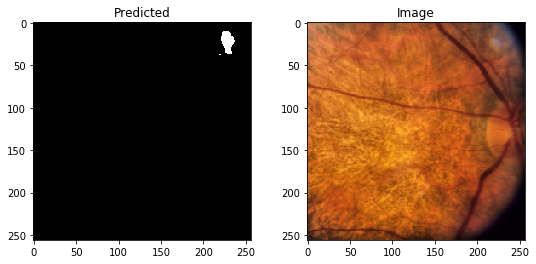

In [60]:
for i, img_no in enumerate(test_idx):
    print('image #{} : '.format(img_no), file_codes[img_no])
    img = X[img_no]
    batch_X = X_valid[i:i + 1]
#     batch_y = Y_valid[i:i + 1]
    
    pred = (model.predict(batch_X)[0, 0] > 0.5).astype(np.float64)
    #corr = Y[img_no][..., 0]
#     corr = th_to_tf_encoding(batch_y)[0, ..., 0]
    
    # mean filtering:
    #pred = mh.mean_filter(pred, Bc=mh.disk(10)) > 0.5
    
    fig = plt.figure(figsize=(9, 4))
    ax = fig.add_subplot(1, 2, 1)
    ax.imshow(pred, cmap=plt.cm.Greys_r)
    ax.set_title('Predicted')
#     ax = fig.add_subplot(1, 3, 2)
#     ax.imshow(corr, cmap=plt.cm.Greys_r)
#     ax.set_title('Correct')
    ax = fig.add_subplot(1, 2, 2)
    #ax.imshow(img)
    ax.imshow(th_to_tf_encoding(batch_X)[0])
    ax.set_title('Image')
    plt.show()
    
#     cur_iou = K.eval(mean_IOU_gpu(pred[None, None, ...], corr[None, None, ...]))
#     cur_dice = K.eval(dice(pred[None, None, ...], corr[None, None, ...]))
#     print('IOU: {}\nDice: {}'.format(cur_iou, cur_dice))
#     pred_iou.append(cur_iou)
#     pred_dice.append(cur_dice)

### Acquiring scores for the validation set

In [ ]:
print(np.mean(pred_iou))
print(np.mean(pred_dice))

### Showing the best and the worst cases

In [ ]:
def show_img_pred_corr(i, file_suffix):    # i is index of image in test_idx
    img_no = test_idx[i]
    batch_X = X[img_no:img_no + 1]
    batch_X = tf_to_th_encoding(batch_X)
    batch_y = Y[img_no:img_no + 1]
    batch_y = tf_to_th_encoding(batch_y)
    batch_X, batch_y = preprocess(batch_X, batch_y, 'test')
    
    pred = model.predict(batch_X)[0, 0] > 0.5
    #corr = Y[img_no][..., 0]
    corr = th_to_tf_encoding(batch_y)[0, ..., 0]
    
    fig = plt.figure(figsize=(9, 4))
    ax = fig.add_subplot(1, 3, 1)
    ax.imshow(pred, cmap=plt.cm.Greys_r)
    ax.set_title('Predicted')
    ax = fig.add_subplot(1, 3, 2)
    ax.imshow(corr, cmap=plt.cm.Greys_r)
    ax.set_title('Correct')
    ax = fig.add_subplot(1, 3, 3)
    #ax.imshow(img)
    ax.imshow(X[img_no])
    ax.set_title('Image')
    plt.show()
    
    plt.imsave('od_rim_one_v3_fold_0_{}_case_image.png'.format(file_suffix), X[img_no])
    plt.imsave('od_rim_one_v3_fold_0_{}_case_pred.png'.format(file_suffix), pred, cmap=plt.cm.Greys_r)
    plt.imsave('od_rim_one_v3_fold_0_{}_case_corr.png'.format(file_suffix), corr, cmap=plt.cm.Greys_r)


best_idx = np.argmax(pred_iou)
worst_idx = np.argmin(pred_iou)
show_img_pred_corr(best_idx, 'best')
print('IOU: {}, Dice: {} (best)'.format(pred_iou[best_idx], pred_dice[best_idx]))
show_img_pred_corr(worst_idx, 'worst')
print('IOU: {}, Dice: {} (worst)'.format(pred_iou[worst_idx], pred_dice[worst_idx]))